<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_tumor_effnet_def.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'


/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [22]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, Dense, Activation
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    # Convert the image to grayscale, and blur it slightly
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    
    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Hyperparameters 
image_size = 224
BATCH_SIZE = 16
hyper_channels = 3

In [10]:
#Bounding box with one tumor
#Define the name of the 3 classes of MRI
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
#Define the list of images for the training 
X_train = []

count = 0;
#Lists of coordinates for resizing bounding box
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []


#Loading training images
for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        #crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        X_train.append(image)

#Load train bounding box labels
image_index = 0
#Define the list of bb coordinates for the training images
bb_list = []
#List used to duplicate images with two bounding box
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)


            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Code to duplicate images with two bounding boxes
print('Dimension of the train list before image duplication:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #Inside bb_list the second label has already been put, now we insert the first label
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimension of the list after image duplication:
print('Dimension of the train list after image duplication:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))


#Load test images
X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        X_test.append(image_test)

#Load the bounding box labels for testing
image_index = 0
count_test = 0;
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                
                #rescaling the bounding box to the correct position after crop
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)


            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Code to duplicate images with two bounding boxes
print('Dimension of the test list before image duplication:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0]) #Inside bb_list the second label has already been put, now we insert the first label

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimension of the test list after image duplication:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

Dimension of the train list before image duplication:
X_train:  878
bb_list:  878
Dimension of the train list after image duplication:
X_train:  919
bb_train:  919
Dimension of the test list before image duplication:
X_test:  223
bb_list:  223
Dimension of the test list after image duplication:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [13]:
#Shuffle of the train dataset
X_train, bb_train = shuffle(X_train, bb_train)

In [14]:
#Validation set creation
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [15]:
#Creation of the three data generator datasets to feed the model with batches of data during the training process
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test, batch_size = BATCH_SIZE)

In [16]:
#Function to define the IoU metrics
def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):

        #define the true and predicted coordinates (height and width)
        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2 
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2

        #Define the bb true area 
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2

        #Define the bb predicted area 
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxIntersection - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxIntersection - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])
        
        #calculate the mean IoU for every image
        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)

        results.append(iou)
    return np.mean(results)

# metric creation
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou


In [ ]:
#def iou(y_true,y_pred):
  #pred_bbox_val = model.predict(X_val)
  #iou = tf.numpy_function(calculate_iou,[y_true,y_pred],tf.float32)
  #return iou

In [17]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in red the real bounding box
        xmin, ymin, width, height = bbox_coords
        img = cv2.rectangle(img, (int(xmin-width/2), int(ymin-height/2)), (int(xmin+width/2), int(ymin+height/2)), (255, 0, 0), 1)
    if len(pred_coords) == 4: #in green the predicted bounding box
        xmin1, ymin1, width1, height1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-width1/2), int(ymin1-height1/2)), (int(xmin1+width1/2), int(ymin1+height1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [18]:
#To test the model during training
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)

In [19]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_EFFNET

save_path = './model_checkpoint_EFFNET/model_EFFNET.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_EFFNET’: File exists


In [20]:
#list of callbacks
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    include_optimizer=False,
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    tf.keras.callbacks.EarlyStopping(
    monitor="val_IoU",
    min_delta=0,
    patience=20,
    verbose=0,
    mode="max",
    baseline=None,
    restore_best_weights=True,
    start_from_epoch=100),
    ShowTestImages()
]

In [23]:
#Transfer learning
effnet = EfficientNetV2B0(weights='imagenet',include_top=False,input_shape=(image_size,image_size,hyper_channels))
#Fine Tuning
model = effnet.output
model = tf.keras.layers.GlobalAveragePooling2D()(model)
model = tf.keras.layers.Dense(4,name='bb_pred')(model)
model = tf.keras.models.Model(inputs=effnet.inputs, outputs = model)

24274472/24274472 [==============================] - 2s 0us/step


In [26]:
%cd '../../..'
%cd '/dataset unzipped'

/
/dataset unzipped


(224, 224, 3)
1/1 [==============================] - 1s 715ms/step


<ipython-input-29-b54dc588c3f3>:43: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure( figsize=(scale * n_features, scale) )


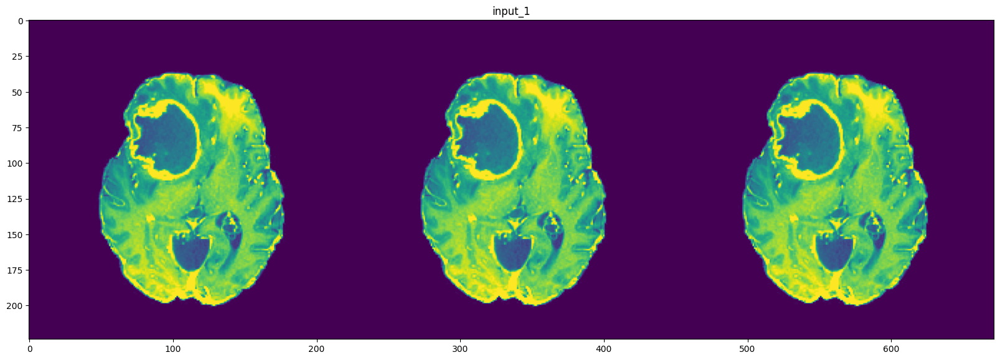

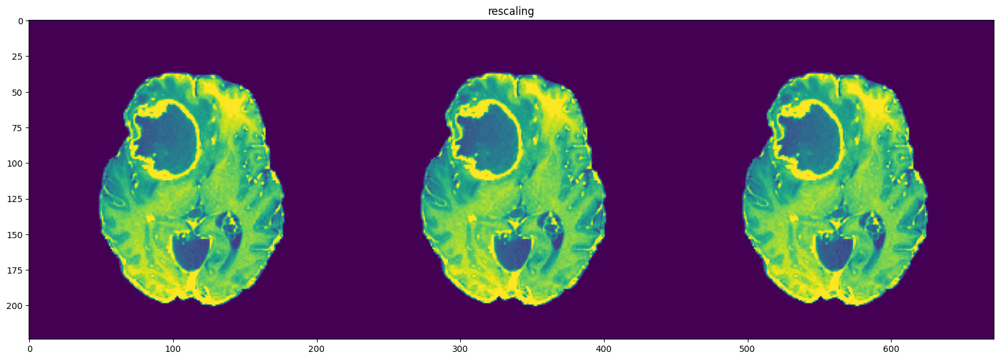

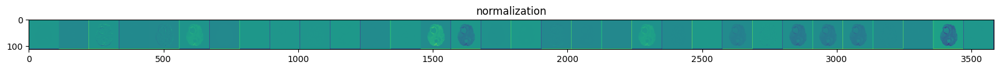

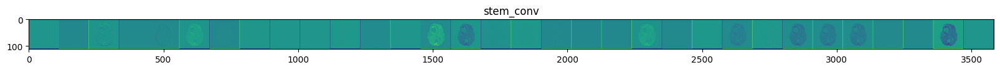

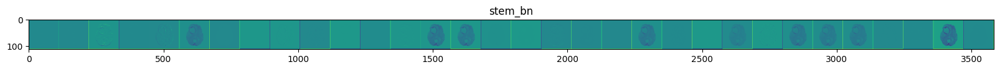

...

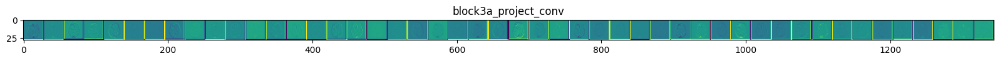

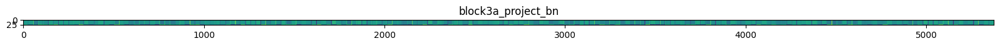

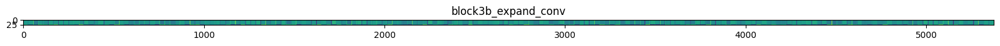

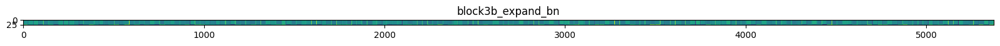

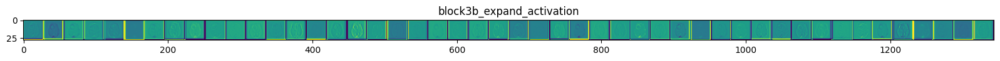

In [29]:
#plot the feature extraction for the first 10 layers of the neural network
from keras.models import Model
img_path='./axial_t1wce_2_class/images/train/00095_188.jpg' 
# Output= intermediate representations for all layers in the  
# previous model after the first.
successive_outputs = [layer.output for layer in model.layers[1:30]]
visualization_model = Model(inputs = model.input, outputs = successive_outputs)
#Load the input image
img = tf.keras.utils.load_img(img_path, target_size=(224, 224))
# Convert ht image to Array of dimension (image_size,image_size,hyper_channels)
x   = tf.keras.utils.img_to_array(img)
np.dot(x, [0.299, 0.587, 0.144])
print(x.shape)                         
x   = x.reshape((1,) + x.shape)# Rescale by 1/255
x /= 255.0
# Let's run input image through our visualization network
# to obtain all intermediate representations for the image.
successive_feature_maps = visualization_model.predict(x)# Retrieve are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  #print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
   
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    #tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be better visualized
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x# Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis' )

In [30]:
#Compilation of the model
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

Epoch 1/150
52/52 [==============================] - ETA: 0s - loss: 48.5873 - IoU: 6.4656e-04
Epoch 1: val_loss improved from inf to 27.96278, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


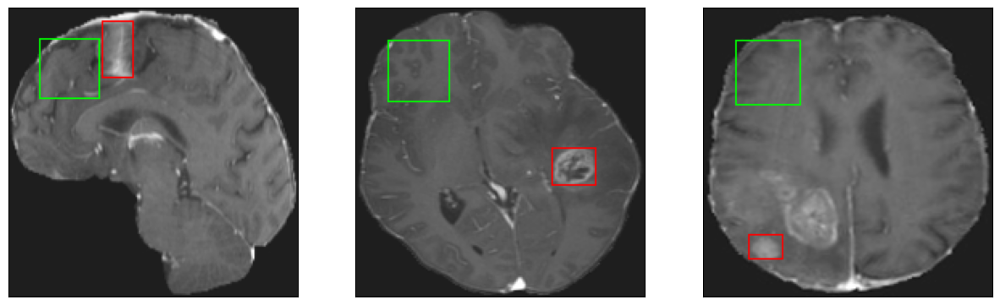

52/52 [==============================] - 76s 327ms/step - loss: 48.5873 - IoU: 6.4656e-04 - val_loss: 27.9628 - val_IoU: 0.0359
Epoch 2/150
52/52 [==============================] - ETA: 0s - loss: 28.4875 - IoU: 0.0427
Epoch 2: val_loss improved from 27.96278 to 22.59482, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


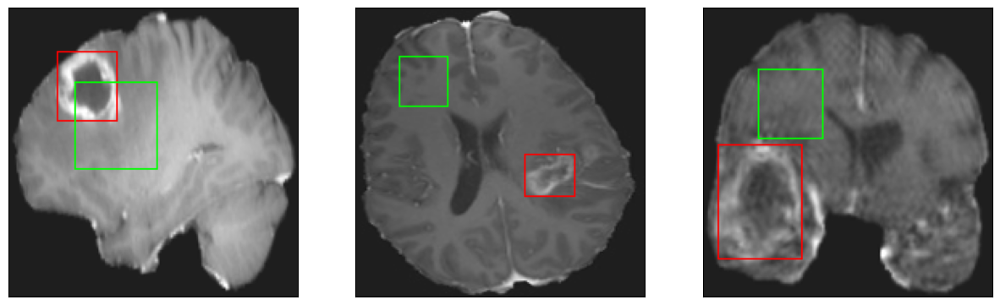

52/52 [==============================] - 8s 156ms/step - loss: 28.4875 - IoU: 0.0427 - val_loss: 22.5948 - val_IoU: 0.0671
Epoch 3/150
52/52 [==============================] - ETA: 0s - loss: 20.6481 - IoU: 0.0955
Epoch 3: val_loss improved from 22.59482 to 18.62681, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


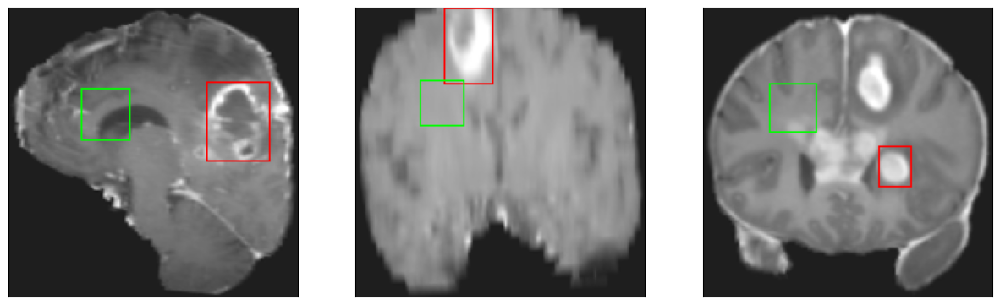

52/52 [==============================] - 7s 142ms/step - loss: 20.6481 - IoU: 0.0955 - val_loss: 18.6268 - val_IoU: 0.0835
Epoch 4/150
52/52 [==============================] - ETA: 0s - loss: 17.7362 - IoU: 0.1151
Epoch 4: val_loss improved from 18.62681 to 15.41626, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


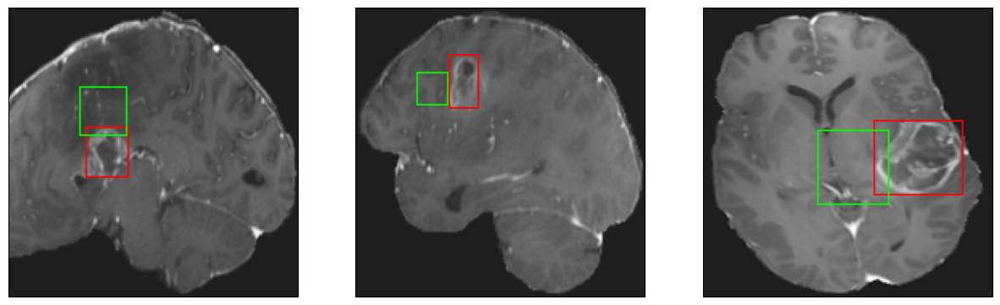

52/52 [==============================] - 8s 159ms/step - loss: 17.7362 - IoU: 0.1151 - val_loss: 15.4163 - val_IoU: 0.1210
Epoch 5/150
52/52 [==============================] - ETA: 0s - loss: 14.7577 - IoU: 0.1756
Epoch 5: val_loss improved from 15.41626 to 11.74655, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


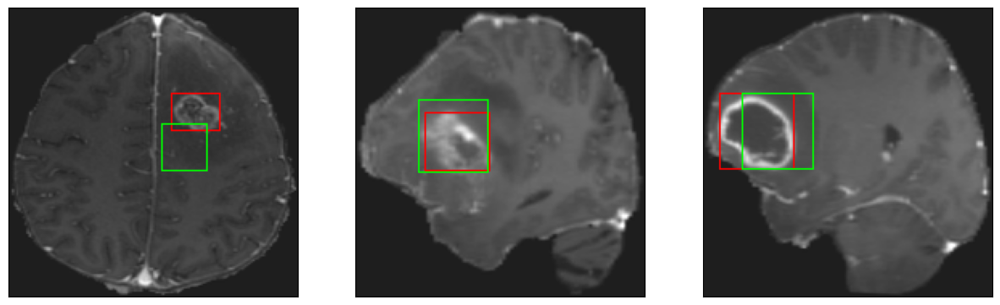

52/52 [==============================] - 7s 138ms/step - loss: 14.7577 - IoU: 0.1756 - val_loss: 11.7466 - val_IoU: 0.2578
Epoch 6/150
52/52 [==============================] - ETA: 0s - loss: 11.9025 - IoU: 0.2557
Epoch 6: val_loss improved from 11.74655 to 8.65458, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


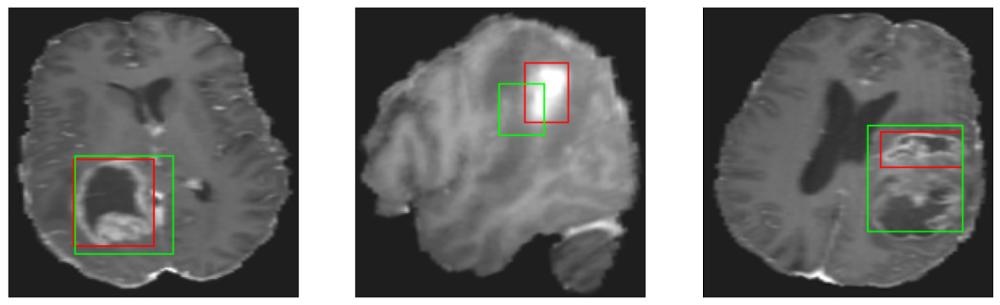

52/52 [==============================] - 8s 151ms/step - loss: 11.9025 - IoU: 0.2557 - val_loss: 8.6546 - val_IoU: 0.3976
Epoch 7/150
52/52 [==============================] - ETA: 0s - loss: 9.4953 - IoU: 0.3389
Epoch 7: val_loss improved from 8.65458 to 8.20019, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


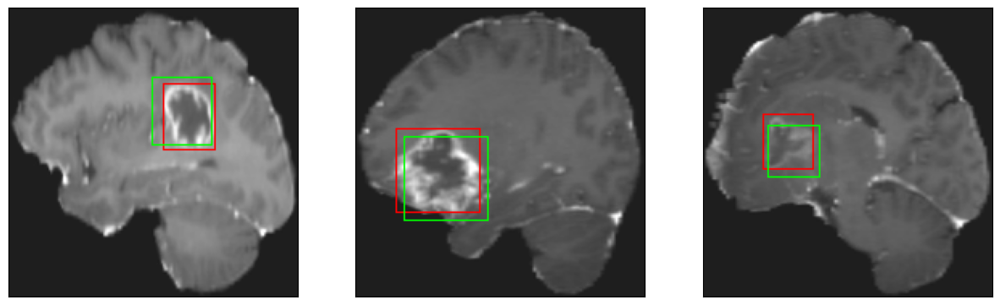

52/52 [==============================] - 8s 144ms/step - loss: 9.4953 - IoU: 0.3389 - val_loss: 8.2002 - val_IoU: 0.4743
Epoch 8/150
52/52 [==============================] - ETA: 0s - loss: 8.7112 - IoU: 0.3604
Epoch 8: val_loss improved from 8.20019 to 6.46035, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


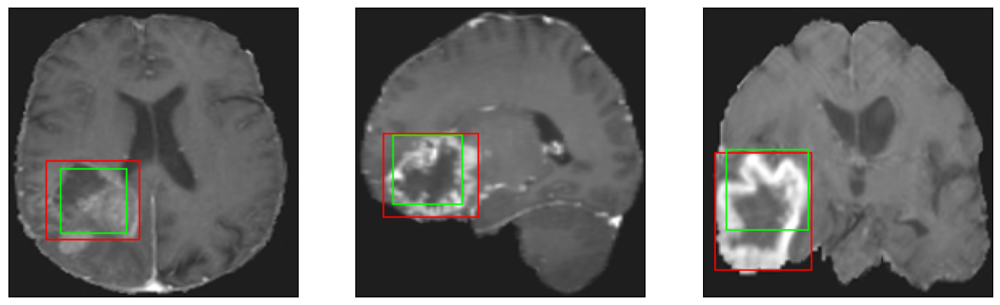

52/52 [==============================] - 8s 145ms/step - loss: 8.7112 - IoU: 0.3604 - val_loss: 6.4603 - val_IoU: 0.5341
Epoch 9/150
52/52 [==============================] - ETA: 0s - loss: 7.9811 - IoU: 0.4007
Epoch 9: val_loss improved from 6.46035 to 6.34877, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


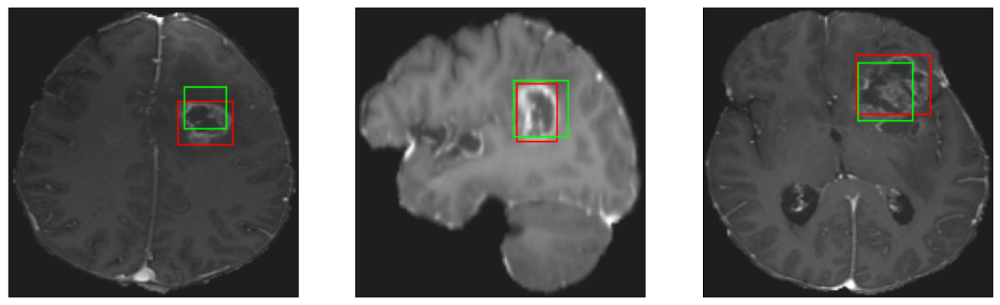

52/52 [==============================] - 7s 142ms/step - loss: 7.9811 - IoU: 0.4007 - val_loss: 6.3488 - val_IoU: 0.5422
Epoch 10/150
52/52 [==============================] - ETA: 0s - loss: 7.1845 - IoU: 0.4424
Epoch 10: val_loss improved from 6.34877 to 5.47186, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


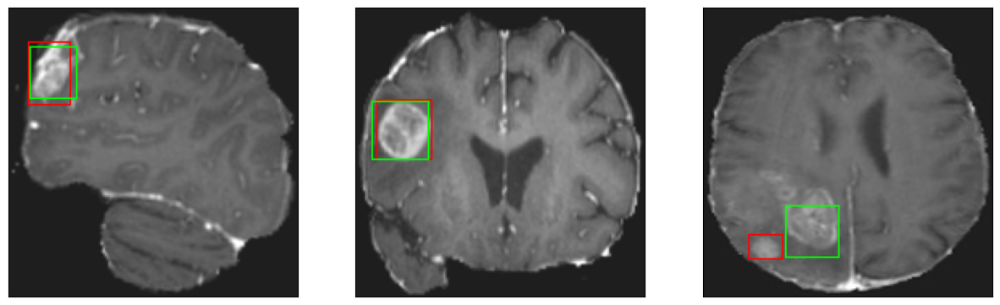

52/52 [==============================] - 8s 159ms/step - loss: 7.1845 - IoU: 0.4424 - val_loss: 5.4719 - val_IoU: 0.5913
Epoch 11/150
52/52 [==============================] - ETA: 0s - loss: 6.6995 - IoU: 0.4769
Epoch 11: val_loss did not improve from 5.47186
8/8 [==============================] - 0s 33ms/step


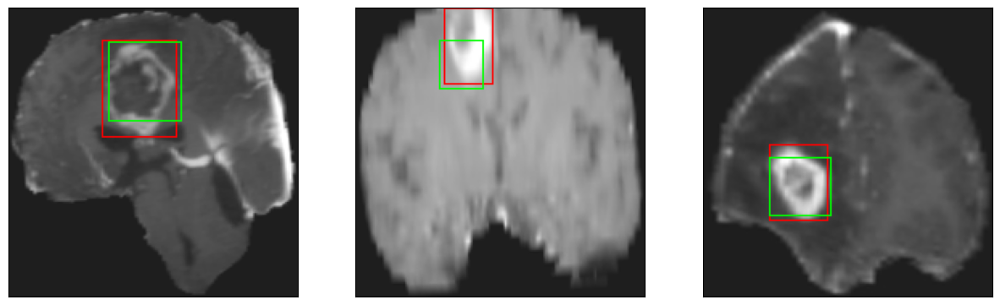

52/52 [==============================] - 6s 124ms/step - loss: 6.6995 - IoU: 0.4769 - val_loss: 5.4756 - val_IoU: 0.5869
Epoch 12/150
52/52 [==============================] - ETA: 0s - loss: 6.7526 - IoU: 0.4598
Epoch 12: val_loss did not improve from 5.47186
8/8 [==============================] - 0s 32ms/step


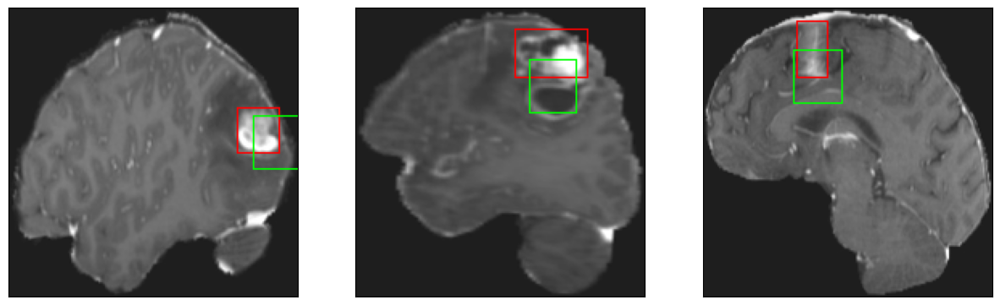

52/52 [==============================] - 7s 128ms/step - loss: 6.7526 - IoU: 0.4598 - val_loss: 6.2004 - val_IoU: 0.5406
Epoch 13/150
52/52 [==============================] - ETA: 0s - loss: 6.2094 - IoU: 0.4936
Epoch 13: val_loss did not improve from 5.47186
8/8 [==============================] - 0s 31ms/step


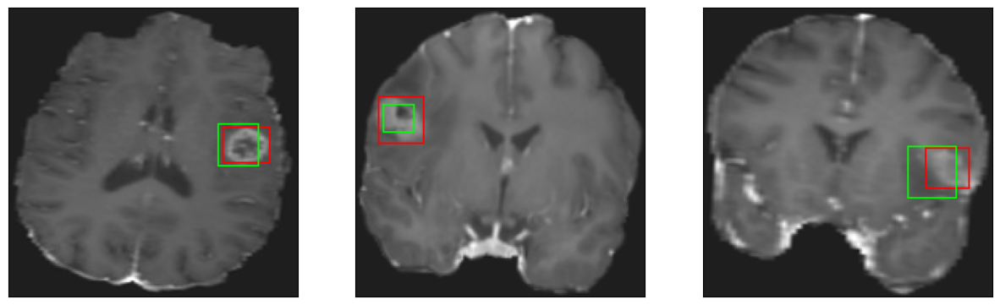

52/52 [==============================] - 6s 117ms/step - loss: 6.2094 - IoU: 0.4936 - val_loss: 6.1621 - val_IoU: 0.5546
Epoch 14/150
52/52 [==============================] - ETA: 0s - loss: 6.1991 - IoU: 0.5046
Epoch 14: val_loss did not improve from 5.47186
8/8 [==============================] - 0s 31ms/step


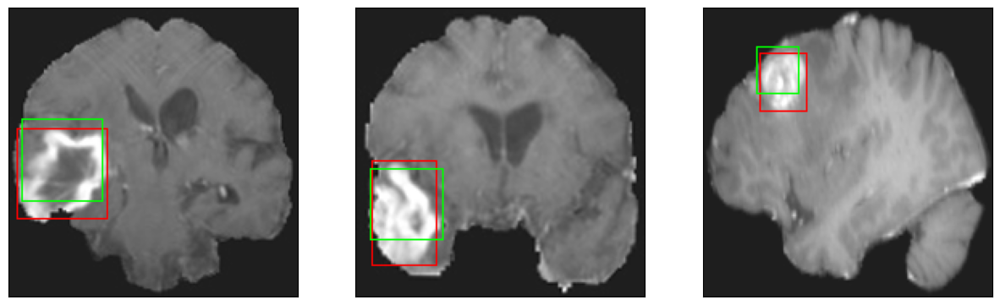

52/52 [==============================] - 6s 117ms/step - loss: 6.1991 - IoU: 0.5046 - val_loss: 6.4615 - val_IoU: 0.4993
Epoch 15/150
52/52 [==============================] - ETA: 0s - loss: 5.7156 - IoU: 0.5276
Epoch 15: val_loss did not improve from 5.47186
8/8 [==============================] - 0s 33ms/step


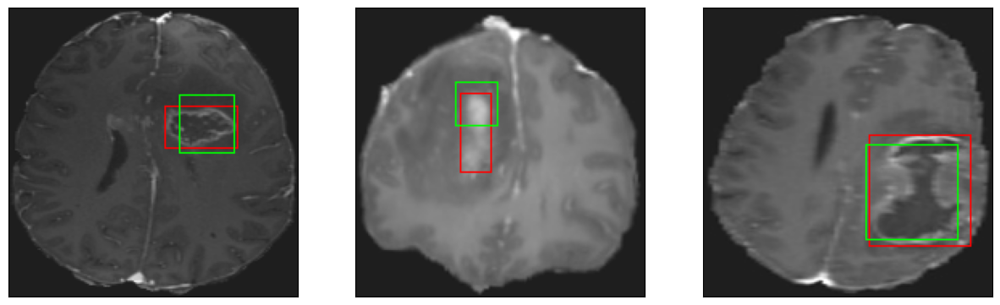

52/52 [==============================] - 7s 131ms/step - loss: 5.7156 - IoU: 0.5276 - val_loss: 6.1038 - val_IoU: 0.5598
Epoch 16/150
52/52 [==============================] - ETA: 0s - loss: 5.9772 - IoU: 0.5186
Epoch 16: val_loss did not improve from 5.47186
8/8 [==============================] - 0s 31ms/step


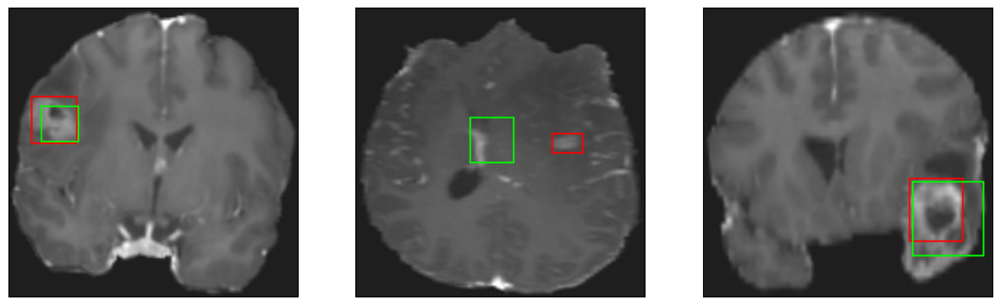

52/52 [==============================] - 6s 120ms/step - loss: 5.9772 - IoU: 0.5186 - val_loss: 5.7153 - val_IoU: 0.5929
Epoch 17/150
52/52 [==============================] - ETA: 0s - loss: 5.7348 - IoU: 0.5371
Epoch 17: val_loss did not improve from 5.47186
8/8 [==============================] - 0s 30ms/step


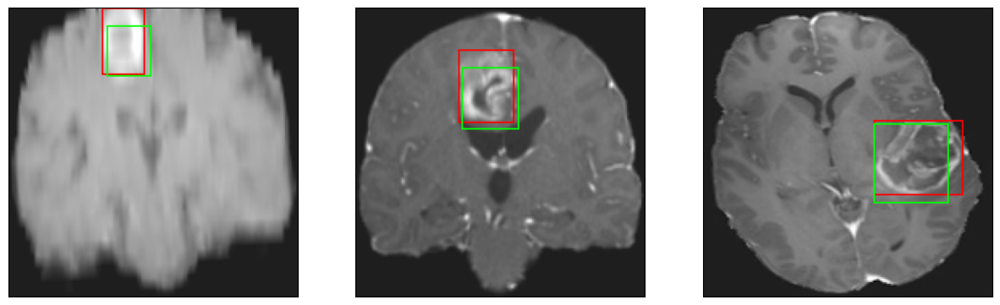

52/52 [==============================] - 6s 121ms/step - loss: 5.7348 - IoU: 0.5371 - val_loss: 5.5278 - val_IoU: 0.5954
Epoch 18/150
52/52 [==============================] - ETA: 0s - loss: 5.6881 - IoU: 0.5427
Epoch 18: val_loss did not improve from 5.47186
8/8 [==============================] - 0s 31ms/step


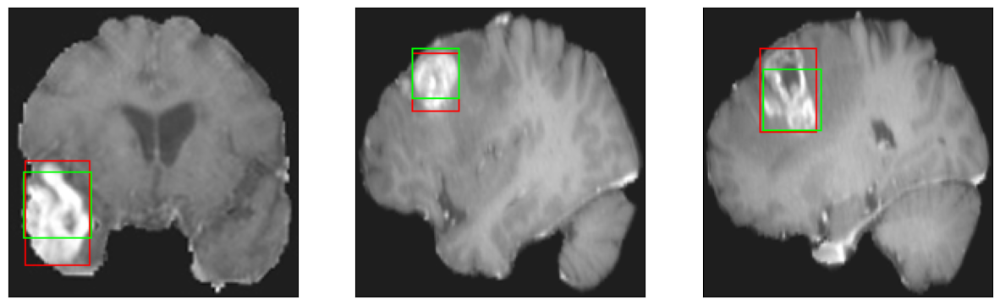

52/52 [==============================] - 6s 123ms/step - loss: 5.6881 - IoU: 0.5427 - val_loss: 5.7885 - val_IoU: 0.5918
Epoch 19/150
52/52 [==============================] - ETA: 0s - loss: 5.6215 - IoU: 0.5450
Epoch 19: val_loss did not improve from 5.47186
8/8 [==============================] - 0s 30ms/step


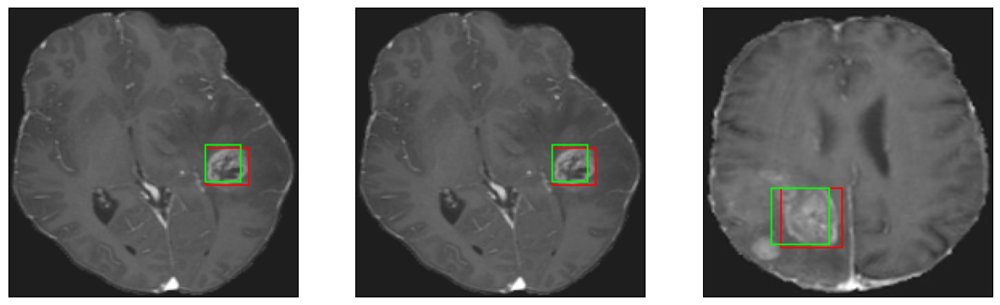

52/52 [==============================] - 6s 122ms/step - loss: 5.6215 - IoU: 0.5450 - val_loss: 5.5097 - val_IoU: 0.6131
Epoch 20/150
52/52 [==============================] - ETA: 0s - loss: 5.2548 - IoU: 0.5722
Epoch 20: val_loss improved from 5.47186 to 5.38564, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


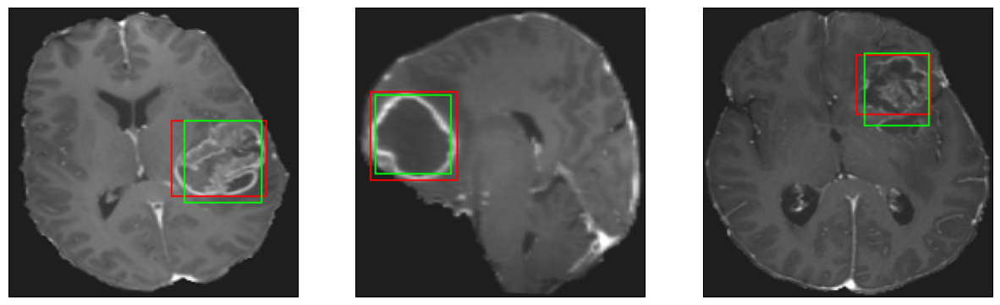

52/52 [==============================] - 8s 157ms/step - loss: 5.2548 - IoU: 0.5722 - val_loss: 5.3856 - val_IoU: 0.6205
Epoch 21/150
52/52 [==============================] - ETA: 0s - loss: 5.2380 - IoU: 0.5757
Epoch 21: val_loss did not improve from 5.38564
8/8 [==============================] - 0s 33ms/step


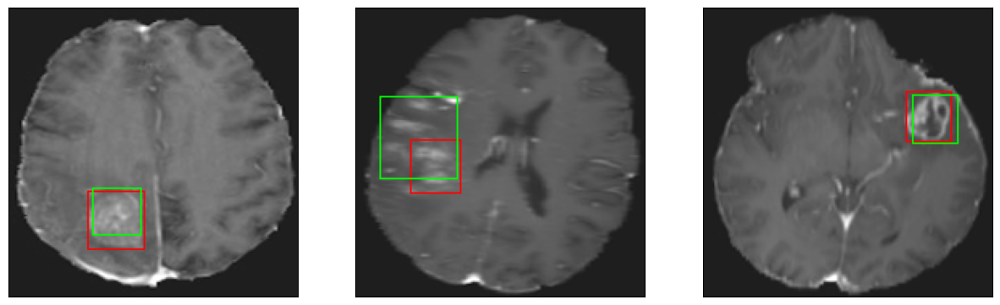

52/52 [==============================] - 6s 121ms/step - loss: 5.2380 - IoU: 0.5757 - val_loss: 5.7015 - val_IoU: 0.5762
Epoch 22/150
52/52 [==============================] - ETA: 0s - loss: 5.0479 - IoU: 0.5973
Epoch 22: val_loss did not improve from 5.38564
8/8 [==============================] - 0s 31ms/step


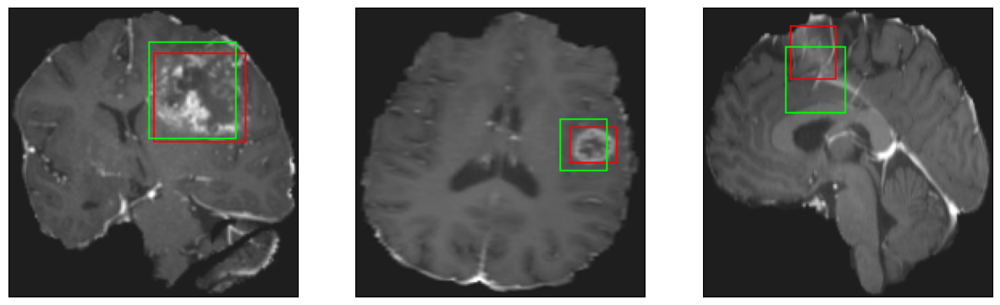

52/52 [==============================] - 7s 140ms/step - loss: 5.0479 - IoU: 0.5973 - val_loss: 6.8291 - val_IoU: 0.5323
Epoch 23/150
52/52 [==============================] - ETA: 0s - loss: 5.3354 - IoU: 0.5686
Epoch 23: val_loss did not improve from 5.38564
8/8 [==============================] - 0s 31ms/step


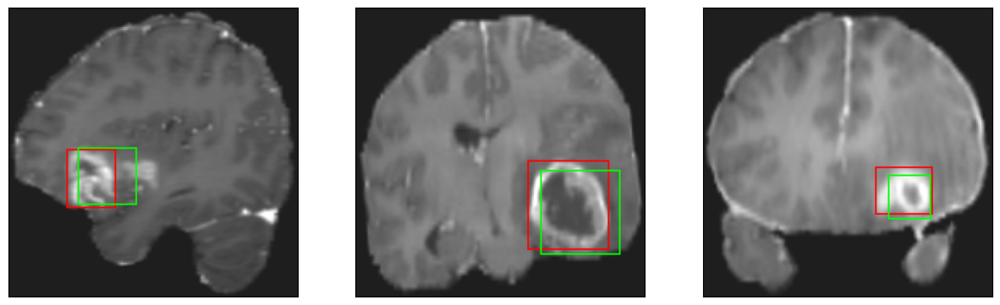

52/52 [==============================] - 7s 126ms/step - loss: 5.3354 - IoU: 0.5686 - val_loss: 5.7697 - val_IoU: 0.5853
Epoch 24/150
52/52 [==============================] - ETA: 0s - loss: 4.9268 - IoU: 0.5919
Epoch 24: val_loss did not improve from 5.38564
8/8 [==============================] - 0s 31ms/step


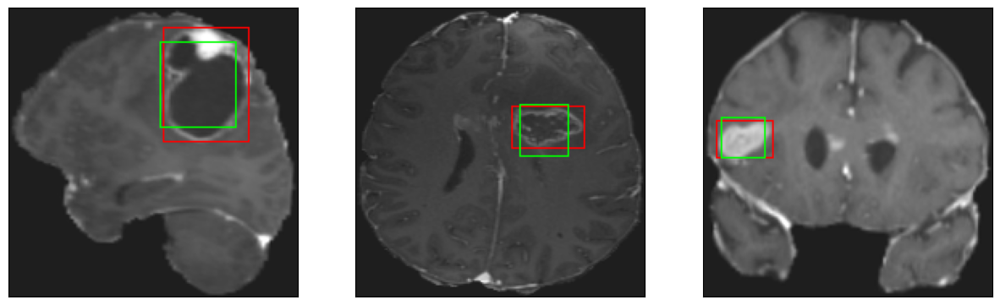

52/52 [==============================] - 6s 121ms/step - loss: 4.9268 - IoU: 0.5919 - val_loss: 5.4501 - val_IoU: 0.5997
Epoch 25/150
52/52 [==============================] - ETA: 0s - loss: 4.8763 - IoU: 0.6054
Epoch 25: val_loss did not improve from 5.38564
8/8 [==============================] - 0s 30ms/step


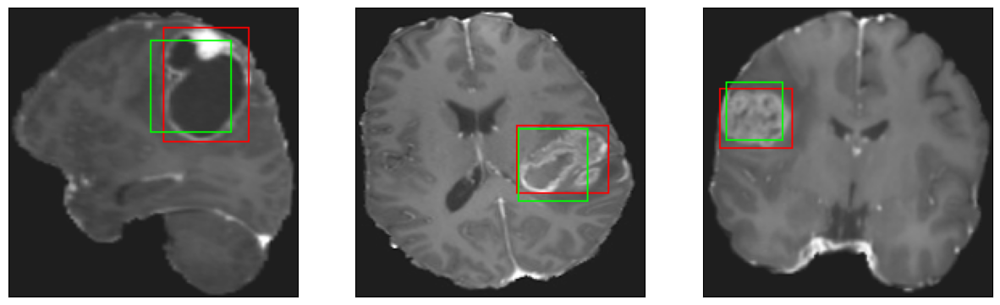

52/52 [==============================] - 8s 145ms/step - loss: 4.8763 - IoU: 0.6054 - val_loss: 6.0665 - val_IoU: 0.5467
Epoch 26/150
52/52 [==============================] - ETA: 0s - loss: 4.9427 - IoU: 0.5974
Epoch 26: val_loss did not improve from 5.38564
8/8 [==============================] - 0s 31ms/step


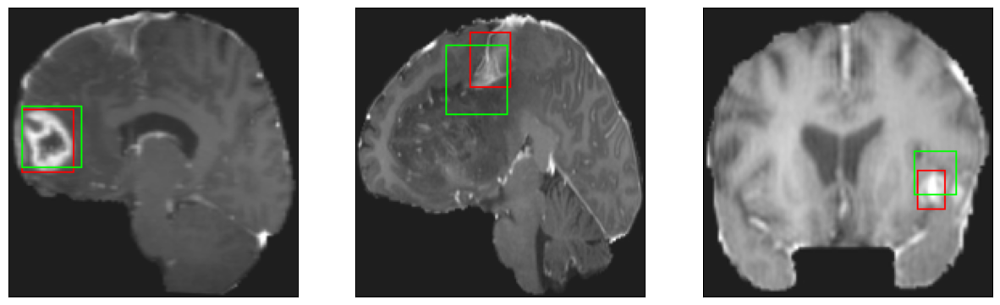

52/52 [==============================] - 6s 122ms/step - loss: 4.9427 - IoU: 0.5974 - val_loss: 5.4180 - val_IoU: 0.6240
Epoch 27/150
52/52 [==============================] - ETA: 0s - loss: 5.0573 - IoU: 0.5998
Epoch 27: val_loss did not improve from 5.38564
8/8 [==============================] - 0s 31ms/step


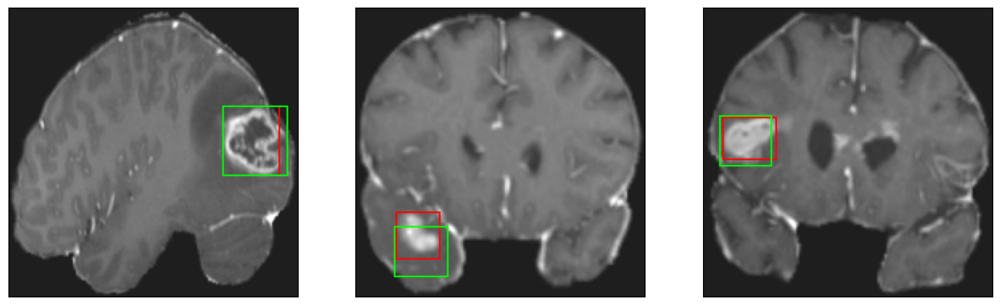

52/52 [==============================] - 7s 133ms/step - loss: 5.0573 - IoU: 0.5998 - val_loss: 6.4243 - val_IoU: 0.5611
Epoch 28/150
52/52 [==============================] - ETA: 0s - loss: 4.7821 - IoU: 0.6074
Epoch 28: val_loss did not improve from 5.38564
8/8 [==============================] - 0s 31ms/step


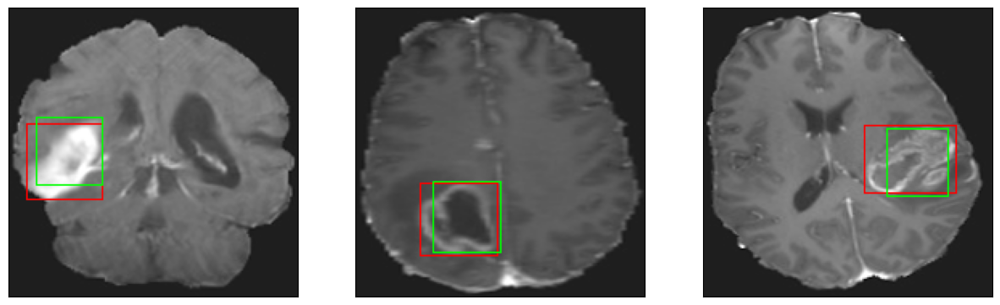

52/52 [==============================] - 6s 122ms/step - loss: 4.7821 - IoU: 0.6074 - val_loss: 5.6047 - val_IoU: 0.5915
Epoch 29/150
52/52 [==============================] - ETA: 0s - loss: 4.4660 - IoU: 0.6423
Epoch 29: val_loss did not improve from 5.38564
8/8 [==============================] - 0s 31ms/step


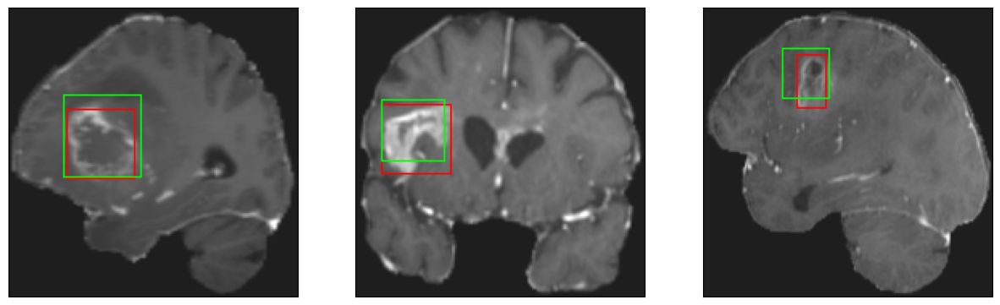

52/52 [==============================] - 7s 129ms/step - loss: 4.4660 - IoU: 0.6423 - val_loss: 5.7391 - val_IoU: 0.5810
Epoch 30/150
52/52 [==============================] - ETA: 0s - loss: 4.5450 - IoU: 0.6304
Epoch 30: val_loss improved from 5.38564 to 5.32013, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


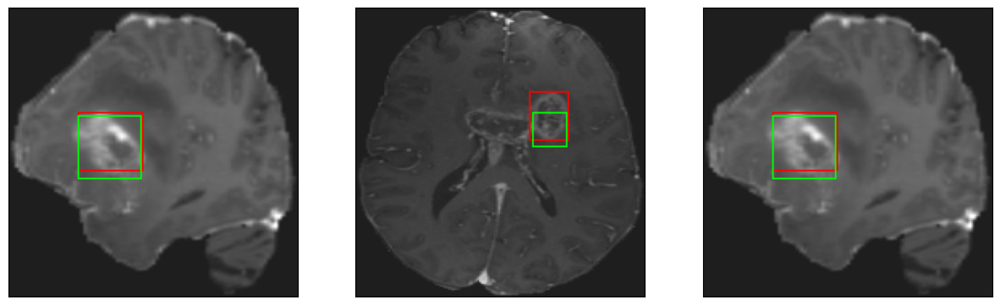

52/52 [==============================] - 10s 196ms/step - loss: 4.5450 - IoU: 0.6304 - val_loss: 5.3201 - val_IoU: 0.6277
Epoch 31/150
52/52 [==============================] - ETA: 0s - loss: 4.4426 - IoU: 0.6373
Epoch 31: val_loss did not improve from 5.32013
8/8 [==============================] - 0s 31ms/step


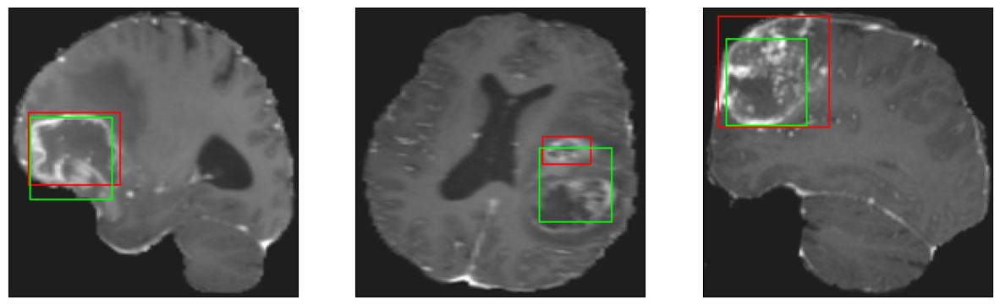

52/52 [==============================] - 7s 131ms/step - loss: 4.4426 - IoU: 0.6373 - val_loss: 5.7233 - val_IoU: 0.5906
Epoch 32/150
52/52 [==============================] - ETA: 0s - loss: 4.3293 - IoU: 0.6429
Epoch 32: val_loss improved from 5.32013 to 5.24383, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


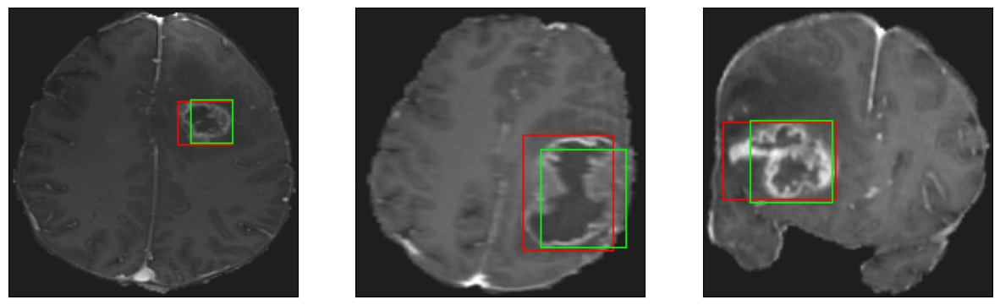

52/52 [==============================] - 10s 183ms/step - loss: 4.3293 - IoU: 0.6429 - val_loss: 5.2438 - val_IoU: 0.6355
Epoch 33/150
52/52 [==============================] - ETA: 0s - loss: 4.4672 - IoU: 0.6196
Epoch 33: val_loss improved from 5.24383 to 5.05464, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


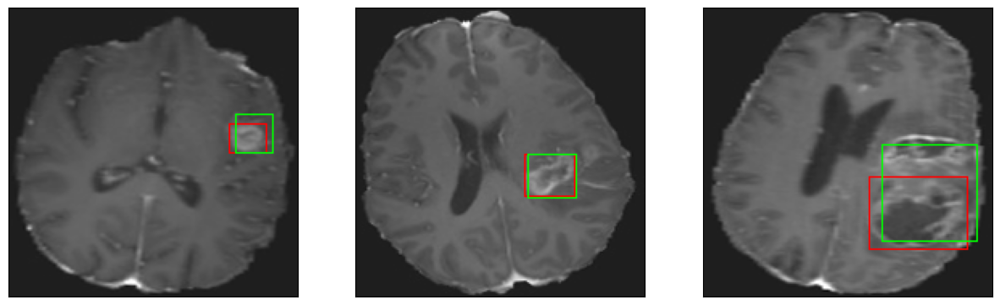

52/52 [==============================] - 9s 170ms/step - loss: 4.4672 - IoU: 0.6196 - val_loss: 5.0546 - val_IoU: 0.6355
Epoch 34/150
52/52 [==============================] - ETA: 0s - loss: 4.2728 - IoU: 0.6410
Epoch 34: val_loss did not improve from 5.05464
8/8 [==============================] - 0s 31ms/step


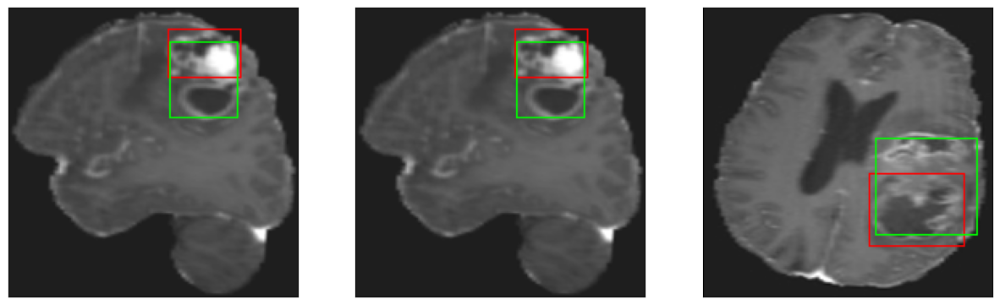

52/52 [==============================] - 6s 124ms/step - loss: 4.2728 - IoU: 0.6410 - val_loss: 5.6362 - val_IoU: 0.6280
Epoch 35/150
52/52 [==============================] - ETA: 0s - loss: 4.2246 - IoU: 0.6449
Epoch 35: val_loss did not improve from 5.05464
8/8 [==============================] - 0s 31ms/step


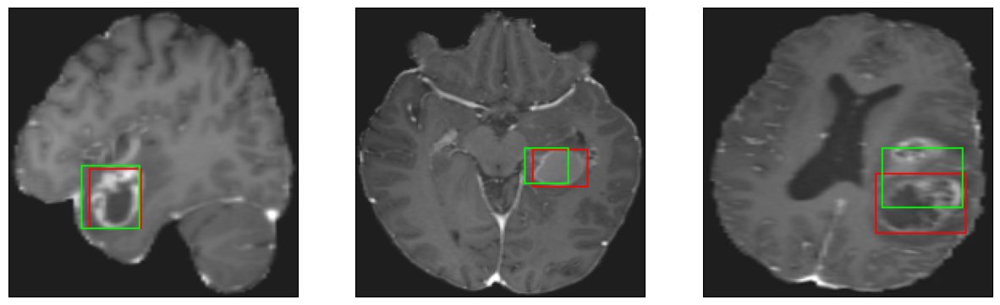

52/52 [==============================] - 7s 125ms/step - loss: 4.2246 - IoU: 0.6449 - val_loss: 5.9151 - val_IoU: 0.5754
Epoch 36/150
52/52 [==============================] - ETA: 0s - loss: 3.8187 - IoU: 0.6754
Epoch 36: val_loss did not improve from 5.05464
8/8 [==============================] - 0s 35ms/step


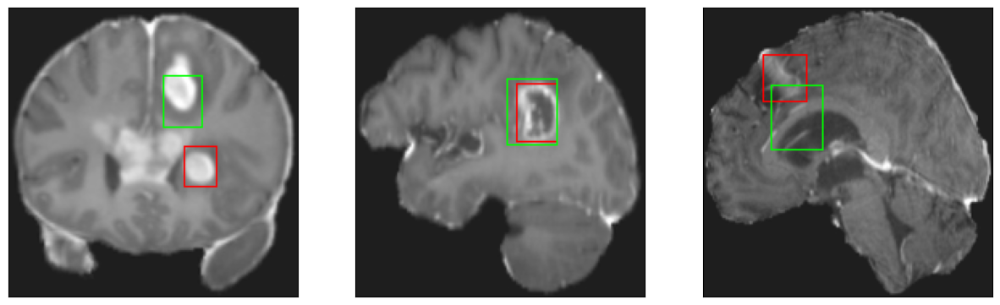

52/52 [==============================] - 7s 132ms/step - loss: 3.8187 - IoU: 0.6754 - val_loss: 5.0840 - val_IoU: 0.6272
Epoch 37/150
52/52 [==============================] - ETA: 0s - loss: 3.9202 - IoU: 0.6682
Epoch 37: val_loss did not improve from 5.05464
8/8 [==============================] - 0s 31ms/step


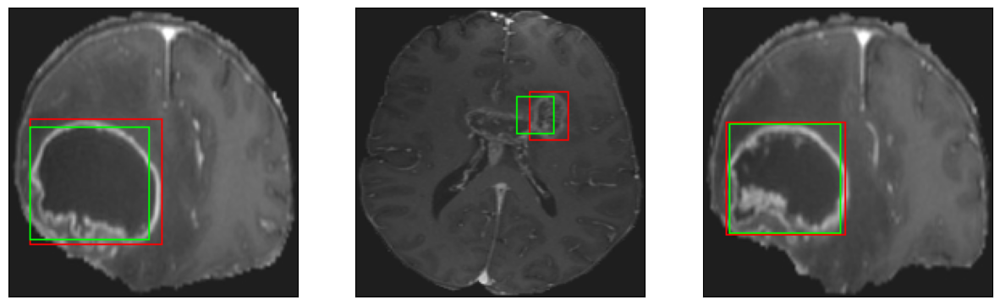

52/52 [==============================] - 7s 128ms/step - loss: 3.9202 - IoU: 0.6682 - val_loss: 5.4433 - val_IoU: 0.5712
Epoch 38/150
52/52 [==============================] - ETA: 0s - loss: 3.8069 - IoU: 0.6734
Epoch 38: val_loss improved from 5.05464 to 4.66623, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


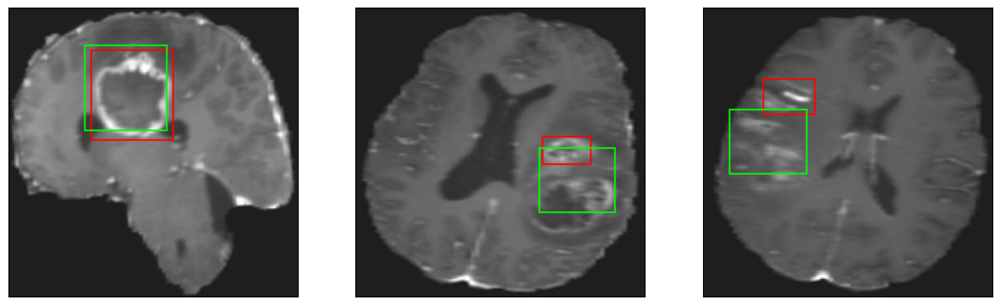

52/52 [==============================] - 9s 164ms/step - loss: 3.8069 - IoU: 0.6734 - val_loss: 4.6662 - val_IoU: 0.6624
Epoch 39/150
52/52 [==============================] - ETA: 0s - loss: 3.5742 - IoU: 0.6924
Epoch 39: val_loss did not improve from 4.66623
8/8 [==============================] - 0s 31ms/step


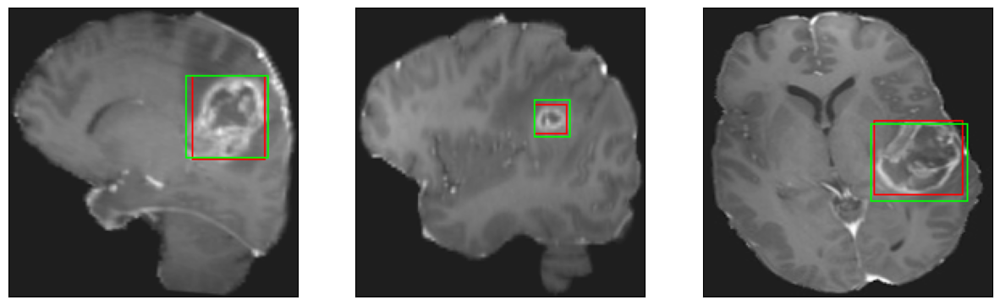

52/52 [==============================] - 8s 151ms/step - loss: 3.5742 - IoU: 0.6924 - val_loss: 5.3049 - val_IoU: 0.6575
Epoch 40/150
52/52 [==============================] - ETA: 0s - loss: 3.6596 - IoU: 0.6863
Epoch 40: val_loss did not improve from 4.66623
8/8 [==============================] - 0s 31ms/step


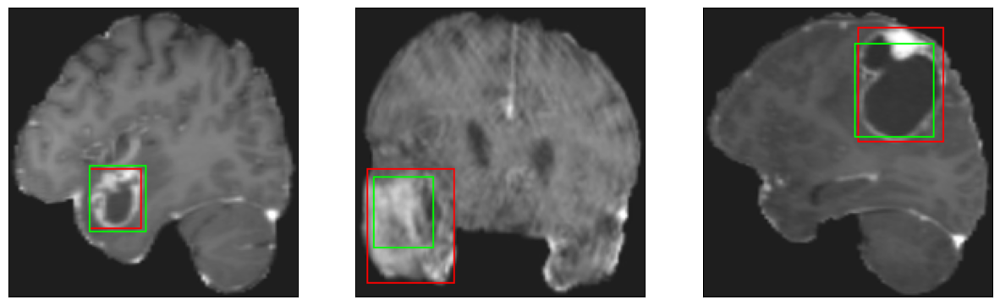

52/52 [==============================] - 7s 128ms/step - loss: 3.6596 - IoU: 0.6863 - val_loss: 4.8976 - val_IoU: 0.6325
Epoch 41/150
52/52 [==============================] - ETA: 0s - loss: 3.6077 - IoU: 0.6943
Epoch 41: val_loss did not improve from 4.66623
8/8 [==============================] - 0s 31ms/step


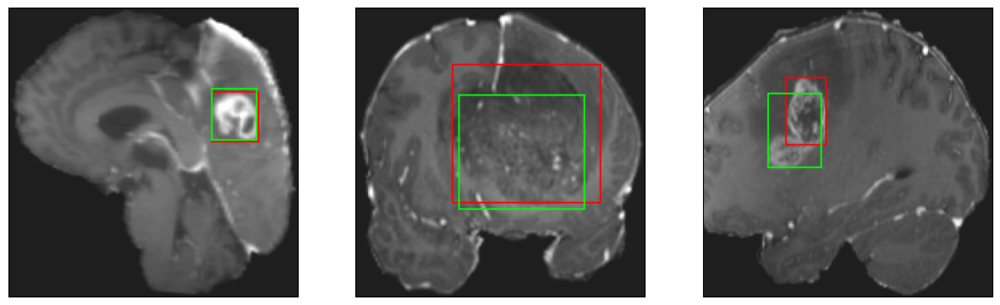

52/52 [==============================] - 7s 130ms/step - loss: 3.6077 - IoU: 0.6943 - val_loss: 4.9607 - val_IoU: 0.6464
Epoch 42/150
52/52 [==============================] - ETA: 0s - loss: 3.5843 - IoU: 0.6891
Epoch 42: val_loss did not improve from 4.66623
8/8 [==============================] - 0s 31ms/step


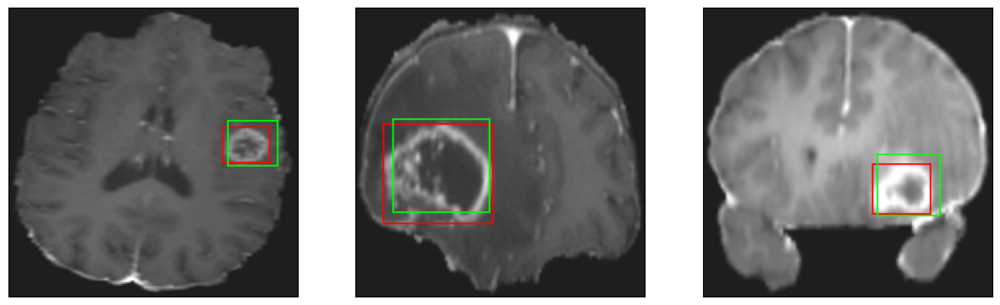

52/52 [==============================] - 7s 128ms/step - loss: 3.5843 - IoU: 0.6891 - val_loss: 4.6788 - val_IoU: 0.6521
Epoch 43/150
52/52 [==============================] - ETA: 0s - loss: 3.3738 - IoU: 0.7093
Epoch 43: val_loss did not improve from 4.66623
8/8 [==============================] - 0s 32ms/step


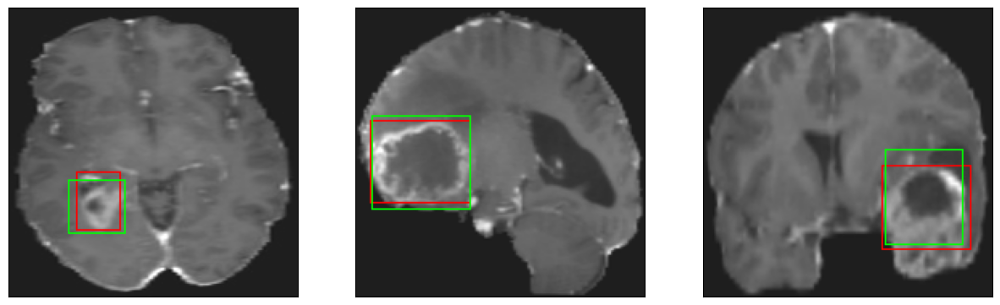

52/52 [==============================] - 7s 137ms/step - loss: 3.3738 - IoU: 0.7093 - val_loss: 5.3042 - val_IoU: 0.6550
Epoch 44/150
52/52 [==============================] - ETA: 0s - loss: 3.5074 - IoU: 0.7081
Epoch 44: val_loss improved from 4.66623 to 4.58747, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


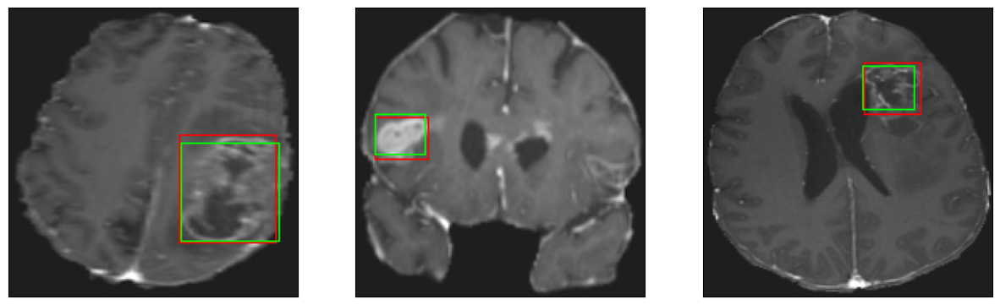

52/52 [==============================] - 9s 176ms/step - loss: 3.5074 - IoU: 0.7081 - val_loss: 4.5875 - val_IoU: 0.6763
Epoch 45/150
52/52 [==============================] - ETA: 0s - loss: 3.5722 - IoU: 0.6826
Epoch 45: val_loss did not improve from 4.58747
8/8 [==============================] - 0s 30ms/step


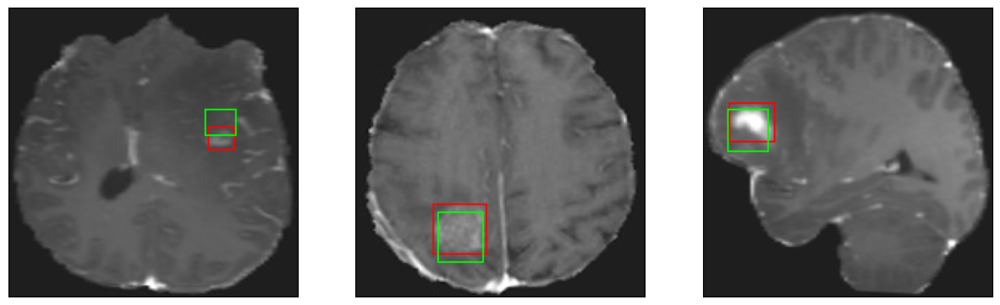

52/52 [==============================] - 7s 139ms/step - loss: 3.5722 - IoU: 0.6826 - val_loss: 4.7198 - val_IoU: 0.6579
Epoch 46/150
52/52 [==============================] - ETA: 0s - loss: 3.4114 - IoU: 0.6946
Epoch 46: val_loss did not improve from 4.58747
8/8 [==============================] - 0s 31ms/step


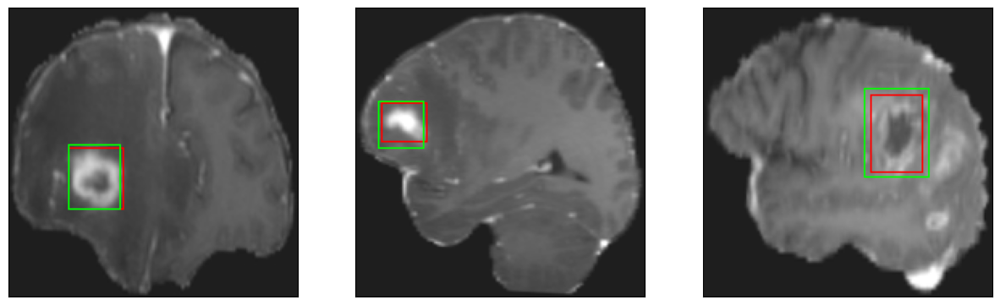

52/52 [==============================] - 7s 132ms/step - loss: 3.4114 - IoU: 0.6946 - val_loss: 5.3413 - val_IoU: 0.6364
Epoch 47/150
52/52 [==============================] - ETA: 0s - loss: 3.4164 - IoU: 0.7029
Epoch 47: val_loss improved from 4.58747 to 4.58674, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


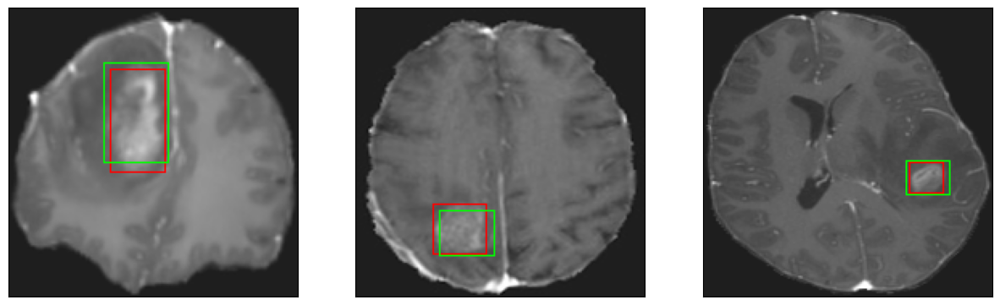

52/52 [==============================] - 9s 172ms/step - loss: 3.4164 - IoU: 0.7029 - val_loss: 4.5867 - val_IoU: 0.6623
Epoch 48/150
52/52 [==============================] - ETA: 0s - loss: 3.2815 - IoU: 0.7131
Epoch 48: val_loss improved from 4.58674 to 4.21326, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


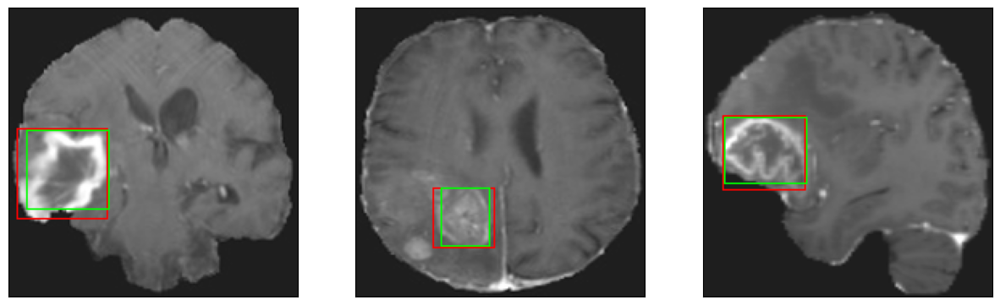

52/52 [==============================] - 8s 163ms/step - loss: 3.2815 - IoU: 0.7131 - val_loss: 4.2133 - val_IoU: 0.7050
Epoch 49/150
52/52 [==============================] - ETA: 0s - loss: 3.2574 - IoU: 0.7133
Epoch 49: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 31ms/step


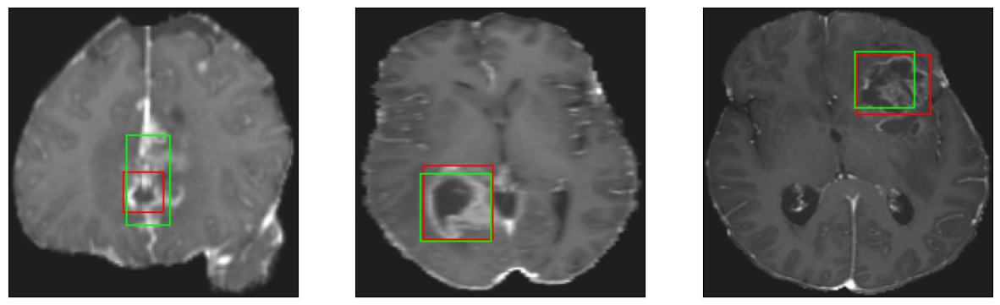

52/52 [==============================] - 7s 137ms/step - loss: 3.2574 - IoU: 0.7133 - val_loss: 4.8640 - val_IoU: 0.6185
Epoch 50/150
52/52 [==============================] - ETA: 0s - loss: 3.2522 - IoU: 0.7060
Epoch 50: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 31ms/step


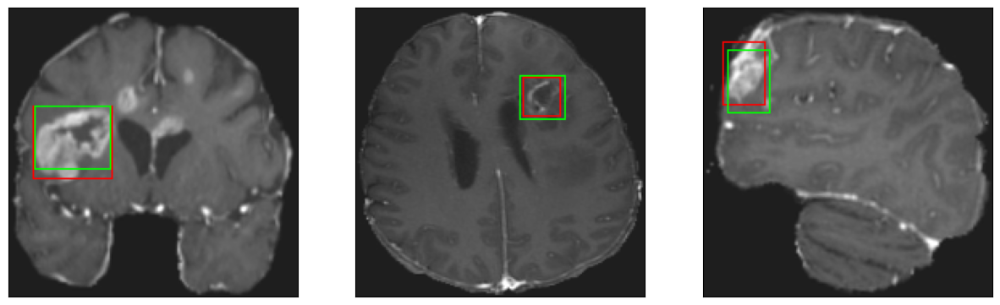

52/52 [==============================] - 7s 129ms/step - loss: 3.2522 - IoU: 0.7060 - val_loss: 4.3124 - val_IoU: 0.6933
Epoch 51/150
52/52 [==============================] - ETA: 0s - loss: 3.2483 - IoU: 0.7160
Epoch 51: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 30ms/step


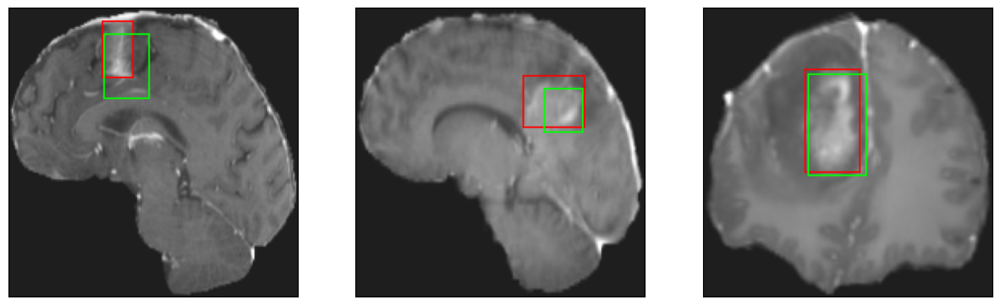

52/52 [==============================] - 7s 125ms/step - loss: 3.2483 - IoU: 0.7160 - val_loss: 4.4691 - val_IoU: 0.6781
Epoch 52/150
52/52 [==============================] - ETA: 0s - loss: 3.1556 - IoU: 0.7214
Epoch 52: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 31ms/step


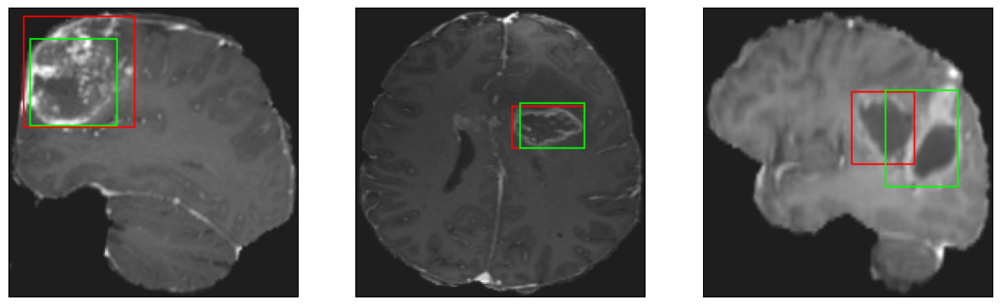

52/52 [==============================] - 7s 132ms/step - loss: 3.1556 - IoU: 0.7214 - val_loss: 4.2373 - val_IoU: 0.7063
Epoch 53/150
52/52 [==============================] - ETA: 0s - loss: 3.1483 - IoU: 0.7210
Epoch 53: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 31ms/step


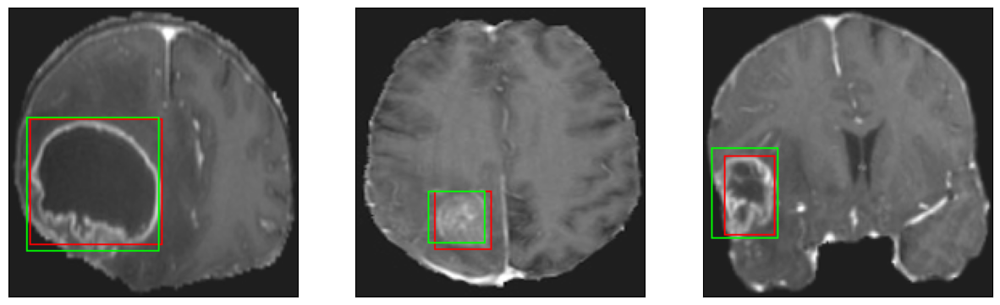

52/52 [==============================] - 6s 124ms/step - loss: 3.1483 - IoU: 0.7210 - val_loss: 5.0340 - val_IoU: 0.6530
Epoch 54/150
52/52 [==============================] - ETA: 0s - loss: 3.2134 - IoU: 0.7157
Epoch 54: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 30ms/step


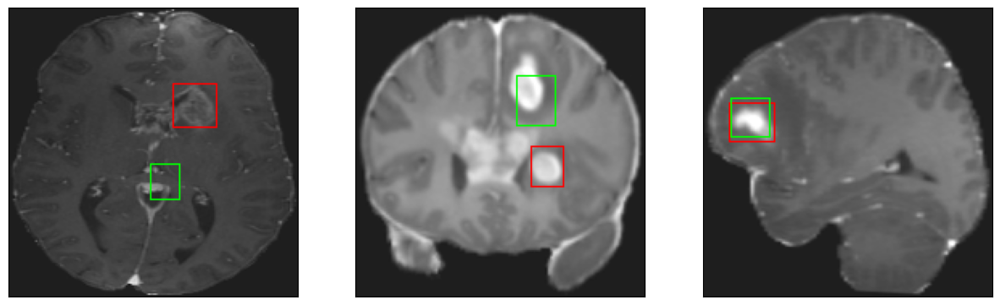

52/52 [==============================] - 7s 132ms/step - loss: 3.2134 - IoU: 0.7157 - val_loss: 4.3436 - val_IoU: 0.6850
Epoch 55/150
52/52 [==============================] - ETA: 0s - loss: 3.0246 - IoU: 0.7267
Epoch 55: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 29ms/step


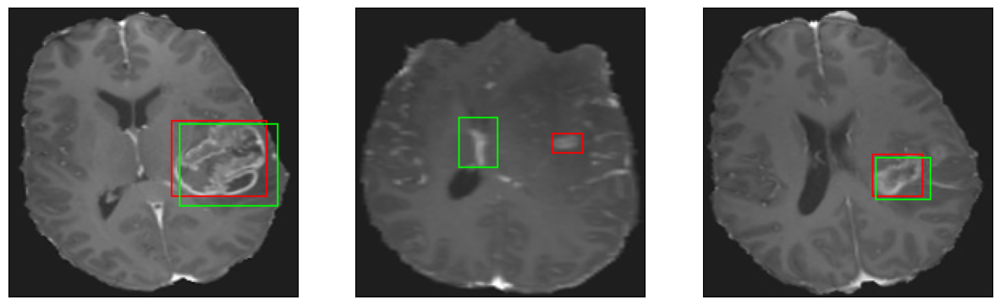

52/52 [==============================] - 7s 138ms/step - loss: 3.0246 - IoU: 0.7267 - val_loss: 5.3634 - val_IoU: 0.6483
Epoch 56/150
52/52 [==============================] - ETA: 0s - loss: 3.1736 - IoU: 0.7161
Epoch 56: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 31ms/step


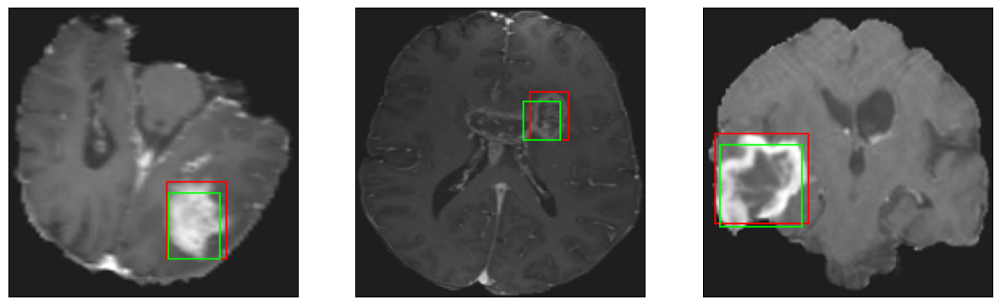

52/52 [==============================] - 6s 124ms/step - loss: 3.1736 - IoU: 0.7161 - val_loss: 5.2112 - val_IoU: 0.6113
Epoch 57/150
52/52 [==============================] - ETA: 0s - loss: 3.0280 - IoU: 0.7363
Epoch 57: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 30ms/step


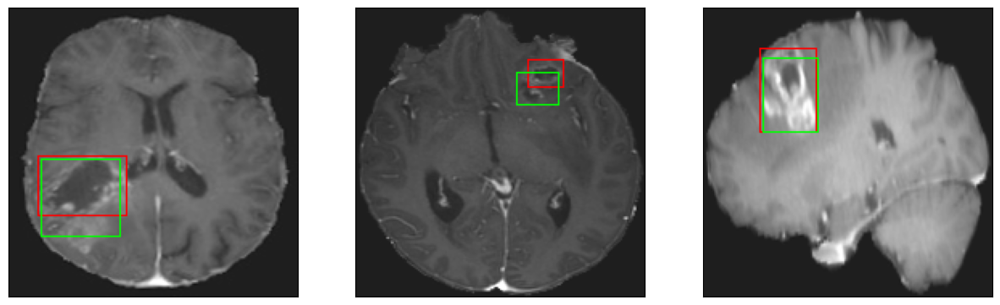

52/52 [==============================] - 7s 144ms/step - loss: 3.0280 - IoU: 0.7363 - val_loss: 4.3414 - val_IoU: 0.6940
Epoch 58/150
52/52 [==============================] - ETA: 0s - loss: 2.9279 - IoU: 0.7374
Epoch 58: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 31ms/step


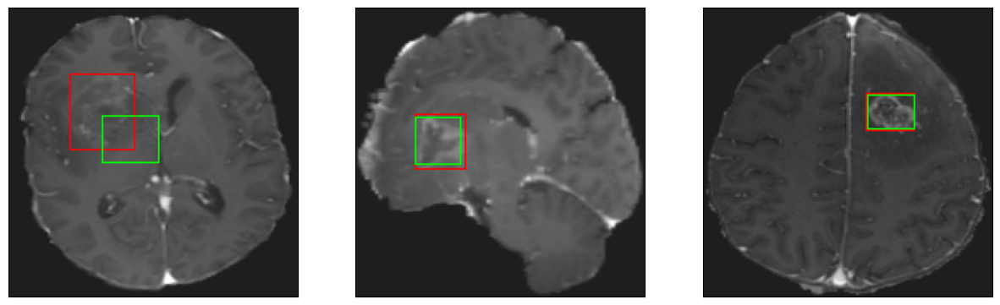

52/52 [==============================] - 7s 138ms/step - loss: 2.9279 - IoU: 0.7374 - val_loss: 4.5859 - val_IoU: 0.6751
Epoch 59/150
52/52 [==============================] - ETA: 0s - loss: 2.9530 - IoU: 0.7369
Epoch 59: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 30ms/step


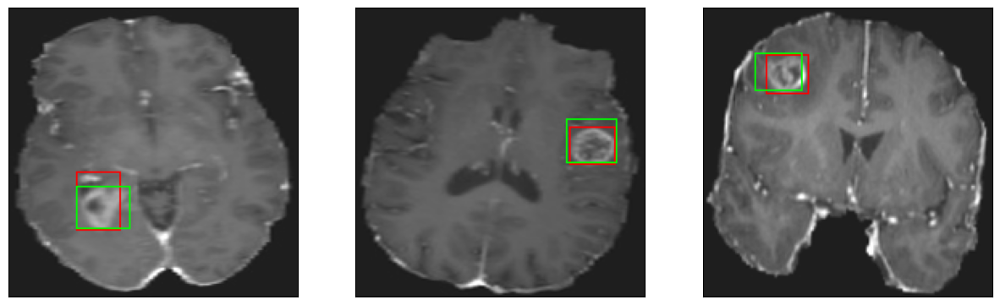

52/52 [==============================] - 7s 133ms/step - loss: 2.9530 - IoU: 0.7369 - val_loss: 4.4759 - val_IoU: 0.6930
Epoch 60/150
52/52 [==============================] - ETA: 0s - loss: 2.8856 - IoU: 0.7362
Epoch 60: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 33ms/step


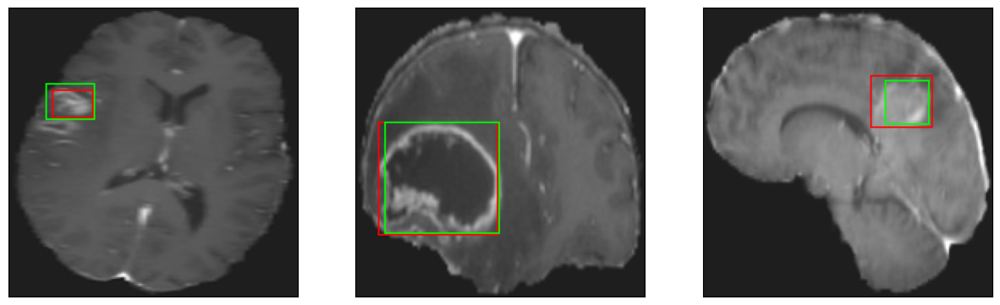

52/52 [==============================] - 8s 147ms/step - loss: 2.8856 - IoU: 0.7362 - val_loss: 4.6043 - val_IoU: 0.6537
Epoch 61/150
52/52 [==============================] - ETA: 0s - loss: 3.1578 - IoU: 0.7198
Epoch 61: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 30ms/step


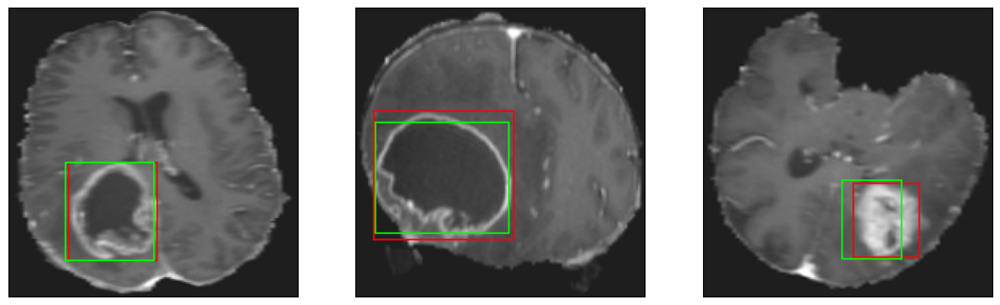

52/52 [==============================] - 7s 128ms/step - loss: 3.1578 - IoU: 0.7198 - val_loss: 5.0030 - val_IoU: 0.6260
Epoch 62/150
52/52 [==============================] - ETA: 0s - loss: 3.0899 - IoU: 0.7277
Epoch 62: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 32ms/step


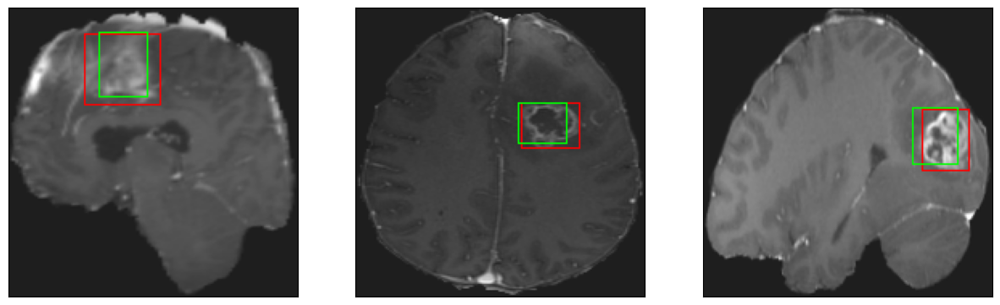

52/52 [==============================] - 7s 143ms/step - loss: 3.0899 - IoU: 0.7277 - val_loss: 4.6106 - val_IoU: 0.6434
Epoch 63/150
52/52 [==============================] - ETA: 0s - loss: 2.9472 - IoU: 0.7309
Epoch 63: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 31ms/step


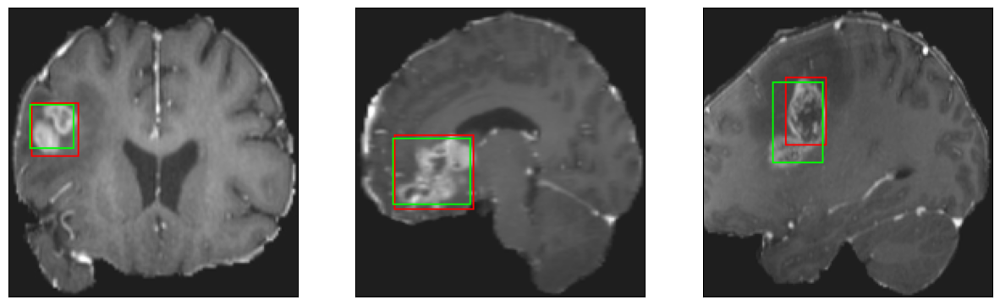

52/52 [==============================] - 7s 129ms/step - loss: 2.9472 - IoU: 0.7309 - val_loss: 4.4286 - val_IoU: 0.6962
Epoch 64/150
52/52 [==============================] - ETA: 0s - loss: 2.8216 - IoU: 0.7482
Epoch 64: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 31ms/step


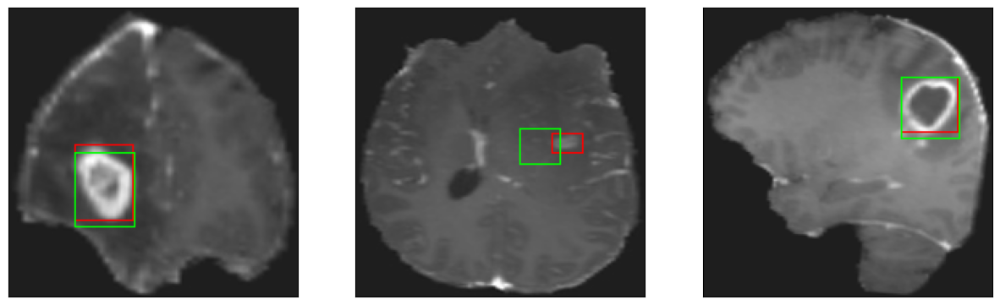

52/52 [==============================] - 7s 139ms/step - loss: 2.8216 - IoU: 0.7482 - val_loss: 4.7320 - val_IoU: 0.6803
Epoch 65/150
52/52 [==============================] - ETA: 0s - loss: 2.8005 - IoU: 0.7480
Epoch 65: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 31ms/step


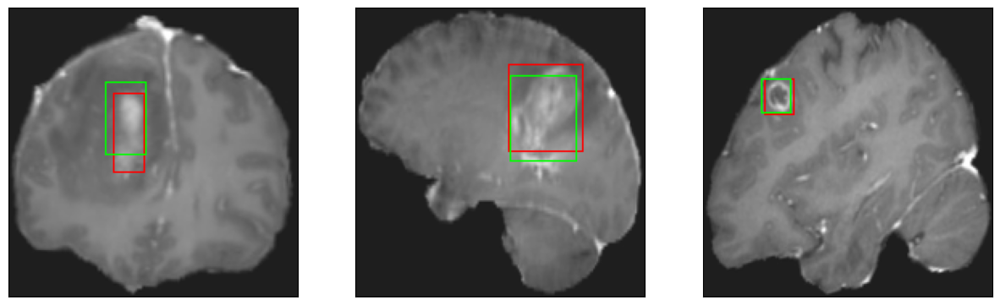

52/52 [==============================] - 6s 123ms/step - loss: 2.8005 - IoU: 0.7480 - val_loss: 4.2930 - val_IoU: 0.7029
Epoch 66/150
52/52 [==============================] - ETA: 0s - loss: 2.7760 - IoU: 0.7409
Epoch 66: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 32ms/step


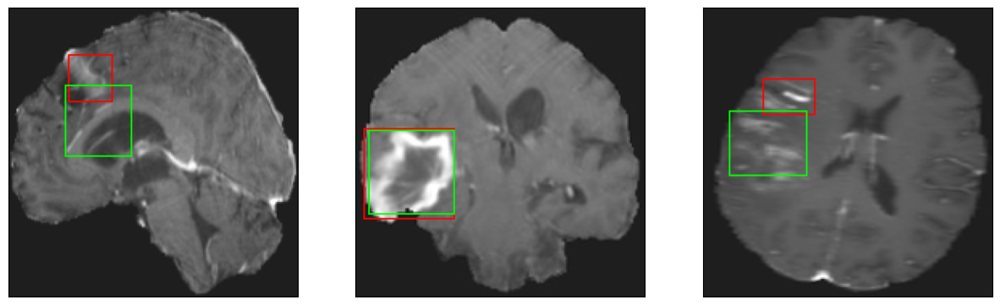

52/52 [==============================] - 7s 133ms/step - loss: 2.7760 - IoU: 0.7409 - val_loss: 4.2416 - val_IoU: 0.6795
Epoch 67/150
52/52 [==============================] - ETA: 0s - loss: 2.9184 - IoU: 0.7329
Epoch 67: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 31ms/step


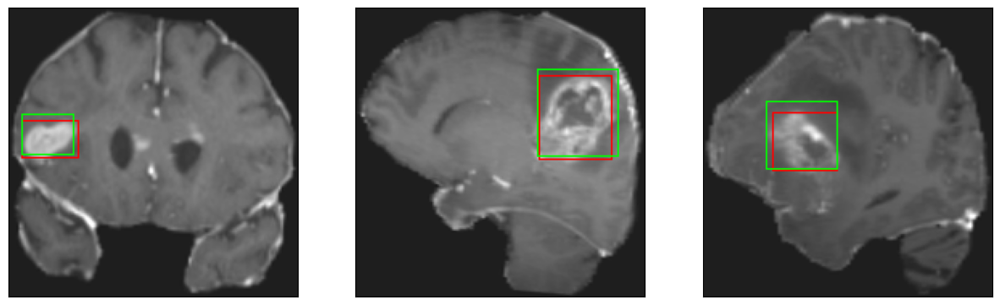

52/52 [==============================] - 7s 130ms/step - loss: 2.9184 - IoU: 0.7329 - val_loss: 4.9840 - val_IoU: 0.6263
Epoch 68/150
52/52 [==============================] - ETA: 0s - loss: 2.7026 - IoU: 0.7522
Epoch 68: val_loss did not improve from 4.21326
8/8 [==============================] - 0s 30ms/step


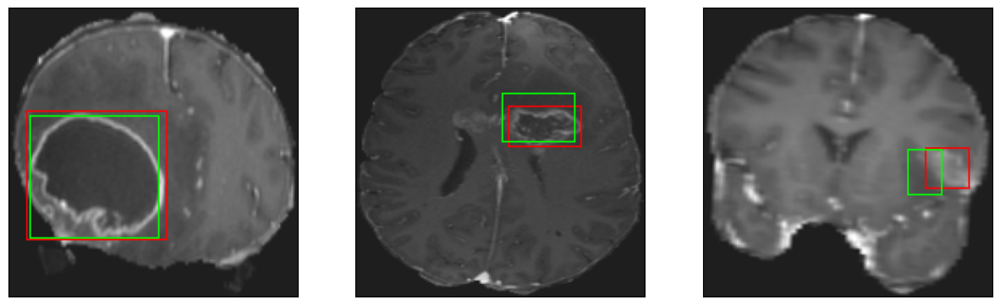

52/52 [==============================] - 7s 132ms/step - loss: 2.7026 - IoU: 0.7522 - val_loss: 4.2629 - val_IoU: 0.6949
Epoch 69/150
52/52 [==============================] - ETA: 0s - loss: 2.5857 - IoU: 0.7602
Epoch 69: val_loss improved from 4.21326 to 4.16465, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 33ms/step


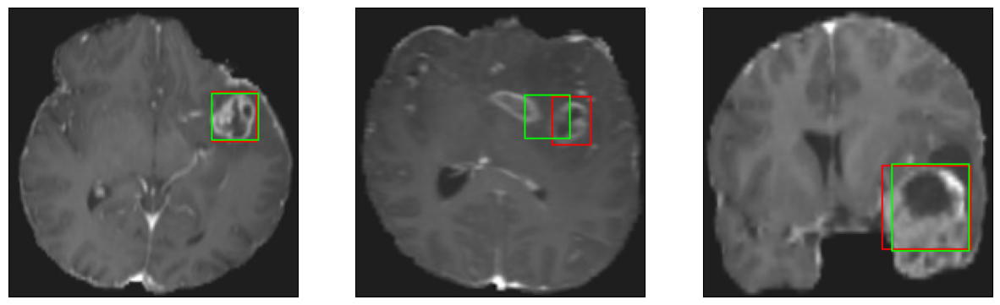

52/52 [==============================] - 9s 178ms/step - loss: 2.5857 - IoU: 0.7602 - val_loss: 4.1646 - val_IoU: 0.7156
Epoch 70/150
52/52 [==============================] - ETA: 0s - loss: 2.5406 - IoU: 0.7636
Epoch 70: val_loss did not improve from 4.16465
8/8 [==============================] - 0s 33ms/step


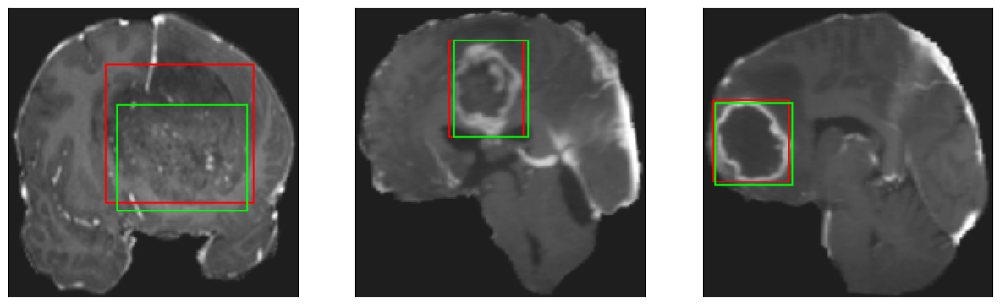

52/52 [==============================] - 7s 133ms/step - loss: 2.5406 - IoU: 0.7636 - val_loss: 4.1781 - val_IoU: 0.7067
Epoch 71/150
52/52 [==============================] - ETA: 0s - loss: 2.7199 - IoU: 0.7452
Epoch 71: val_loss did not improve from 4.16465
8/8 [==============================] - 0s 31ms/step


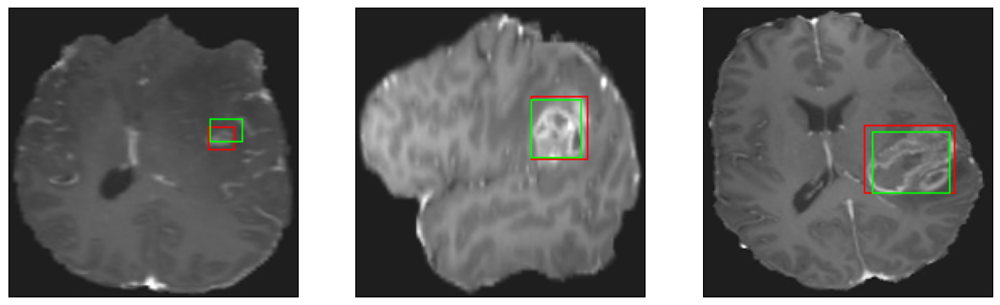

52/52 [==============================] - 7s 141ms/step - loss: 2.7199 - IoU: 0.7452 - val_loss: 4.7681 - val_IoU: 0.6363
Epoch 72/150
52/52 [==============================] - ETA: 0s - loss: 2.6380 - IoU: 0.7598
Epoch 72: val_loss improved from 4.16465 to 4.16074, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


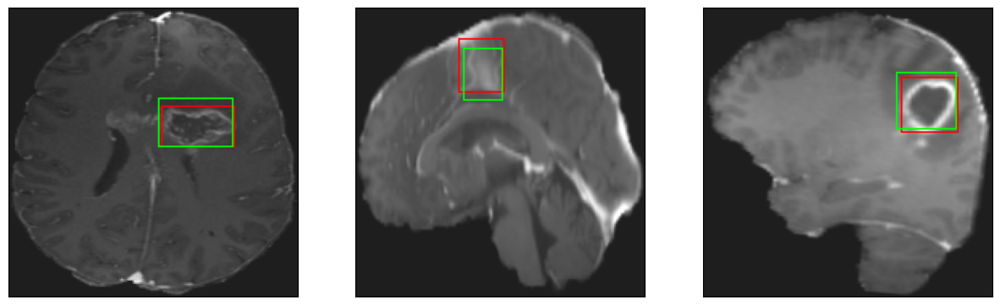

52/52 [==============================] - 9s 176ms/step - loss: 2.6380 - IoU: 0.7598 - val_loss: 4.1607 - val_IoU: 0.7043
Epoch 73/150
52/52 [==============================] - ETA: 0s - loss: 2.5549 - IoU: 0.7584
Epoch 73: val_loss did not improve from 4.16074
8/8 [==============================] - 0s 31ms/step


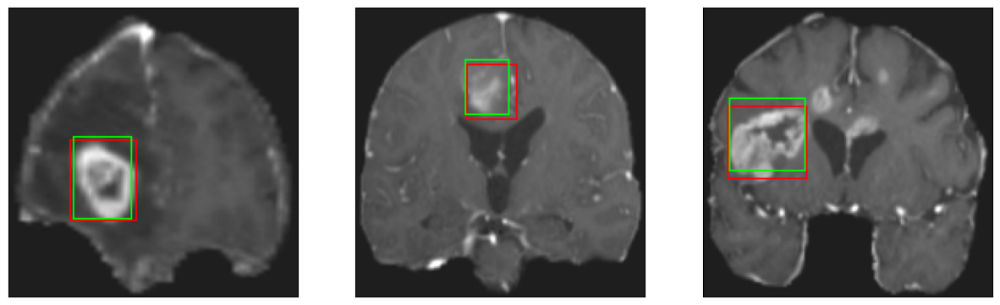

52/52 [==============================] - 7s 136ms/step - loss: 2.5549 - IoU: 0.7584 - val_loss: 4.2863 - val_IoU: 0.6839
Epoch 74/150
52/52 [==============================] - ETA: 0s - loss: 2.5767 - IoU: 0.7605
Epoch 74: val_loss did not improve from 4.16074
8/8 [==============================] - 0s 35ms/step


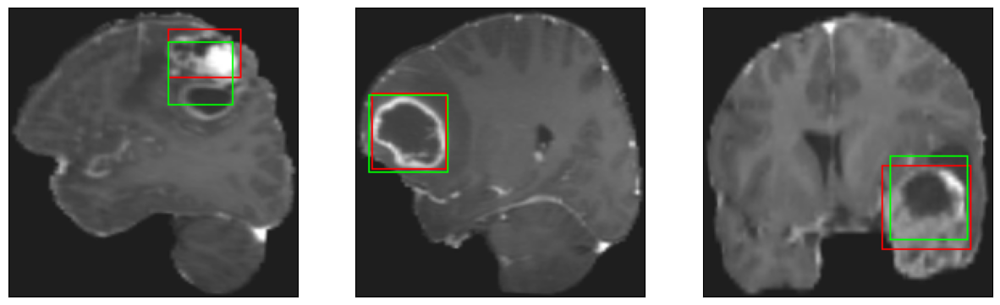

52/52 [==============================] - 7s 135ms/step - loss: 2.5767 - IoU: 0.7605 - val_loss: 4.4095 - val_IoU: 0.6707
Epoch 75/150
52/52 [==============================] - ETA: 0s - loss: 2.5722 - IoU: 0.7592
Epoch 75: val_loss improved from 4.16074 to 4.12958, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


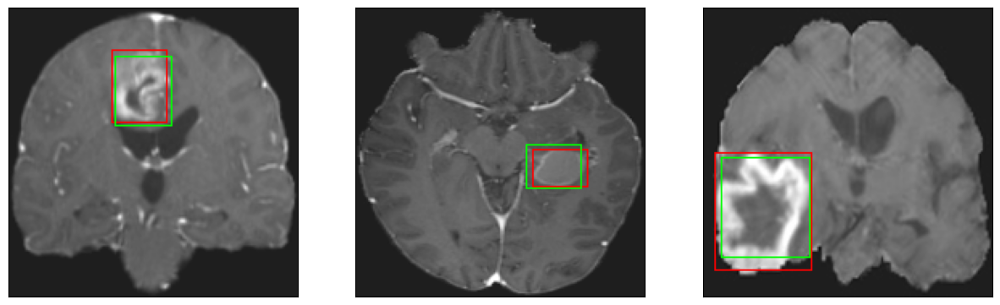

52/52 [==============================] - 9s 171ms/step - loss: 2.5722 - IoU: 0.7592 - val_loss: 4.1296 - val_IoU: 0.7085
Epoch 76/150
52/52 [==============================] - ETA: 0s - loss: 2.5105 - IoU: 0.7718
Epoch 76: val_loss did not improve from 4.12958
8/8 [==============================] - 0s 32ms/step


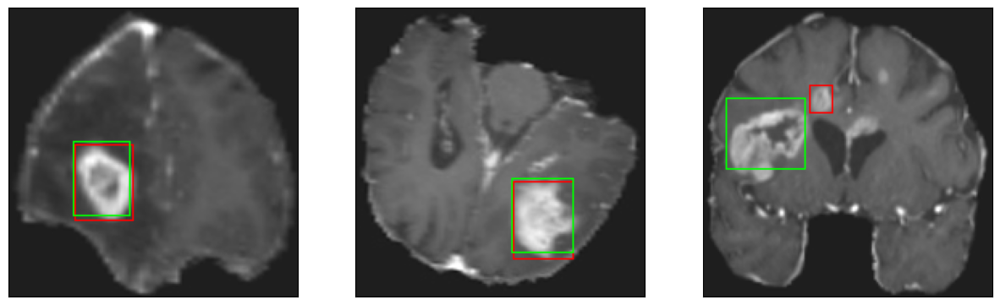

52/52 [==============================] - 8s 150ms/step - loss: 2.5105 - IoU: 0.7718 - val_loss: 4.4563 - val_IoU: 0.6710
Epoch 77/150
52/52 [==============================] - ETA: 0s - loss: 2.5202 - IoU: 0.7648
Epoch 77: val_loss did not improve from 4.12958
8/8 [==============================] - 0s 32ms/step


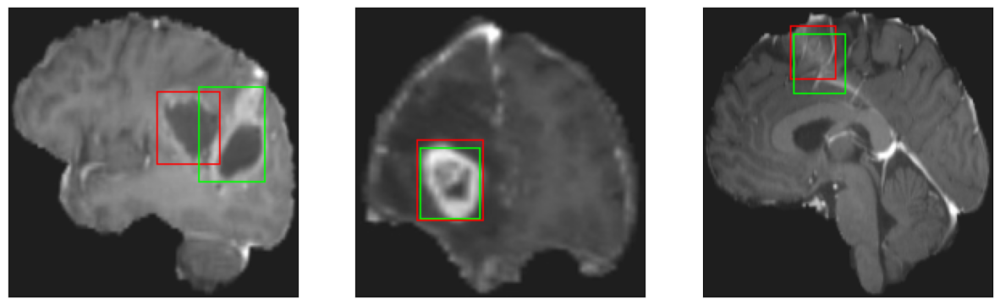

52/52 [==============================] - 7s 132ms/step - loss: 2.5202 - IoU: 0.7648 - val_loss: 4.1533 - val_IoU: 0.7163
Epoch 78/150
52/52 [==============================] - ETA: 0s - loss: 2.5270 - IoU: 0.7657
Epoch 78: val_loss did not improve from 4.12958
8/8 [==============================] - 0s 32ms/step


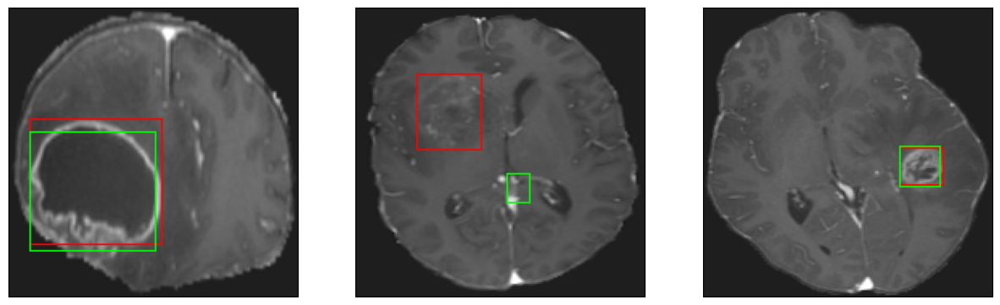

52/52 [==============================] - 7s 128ms/step - loss: 2.5270 - IoU: 0.7657 - val_loss: 4.2714 - val_IoU: 0.6941
Epoch 79/150
52/52 [==============================] - ETA: 0s - loss: 2.9816 - IoU: 0.7326
Epoch 79: val_loss did not improve from 4.12958
8/8 [==============================] - 0s 31ms/step


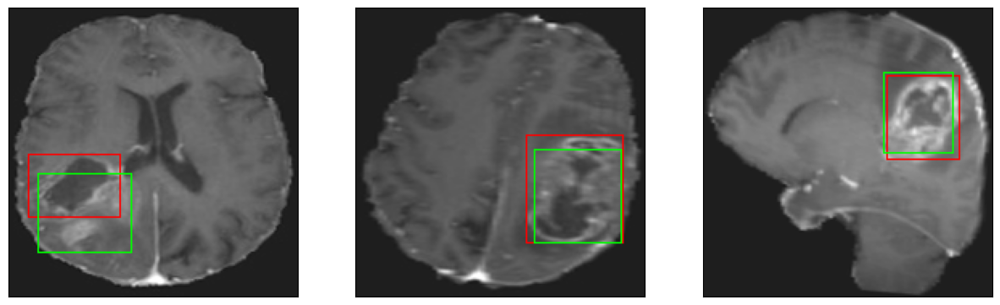

52/52 [==============================] - 7s 133ms/step - loss: 2.9816 - IoU: 0.7326 - val_loss: 4.4263 - val_IoU: 0.6532
Epoch 80/150
52/52 [==============================] - ETA: 0s - loss: 2.6191 - IoU: 0.7598
Epoch 80: val_loss did not improve from 4.12958
8/8 [==============================] - 0s 31ms/step


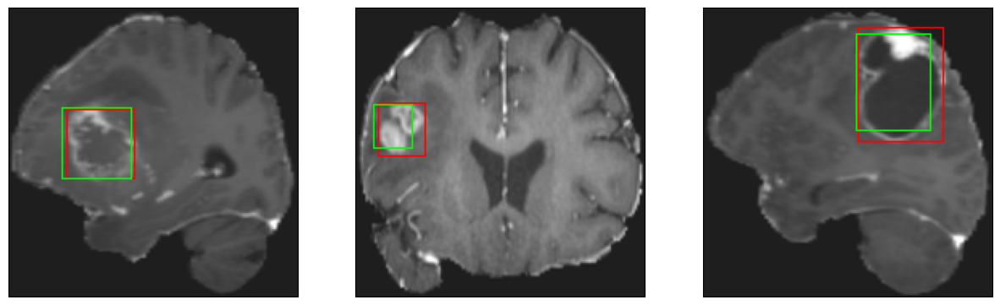

52/52 [==============================] - 7s 132ms/step - loss: 2.6191 - IoU: 0.7598 - val_loss: 4.4638 - val_IoU: 0.6733
Epoch 81/150
52/52 [==============================] - ETA: 0s - loss: 2.5413 - IoU: 0.7704
Epoch 81: val_loss did not improve from 4.12958
8/8 [==============================] - 0s 31ms/step


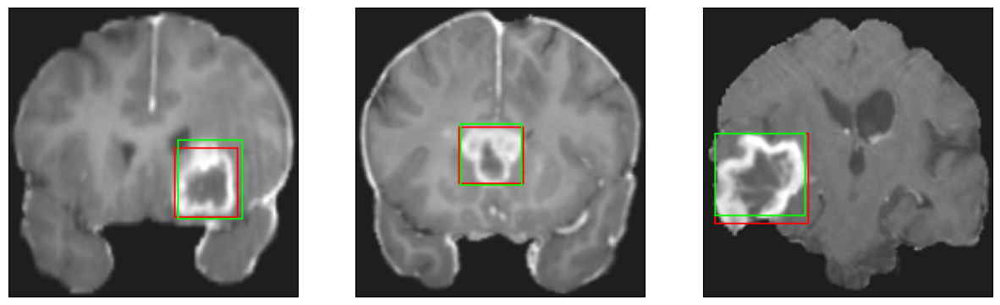

52/52 [==============================] - 7s 127ms/step - loss: 2.5413 - IoU: 0.7704 - val_loss: 4.1996 - val_IoU: 0.6988
Epoch 82/150
52/52 [==============================] - ETA: 0s - loss: 2.4426 - IoU: 0.7732
Epoch 82: val_loss did not improve from 4.12958
8/8 [==============================] - 0s 32ms/step


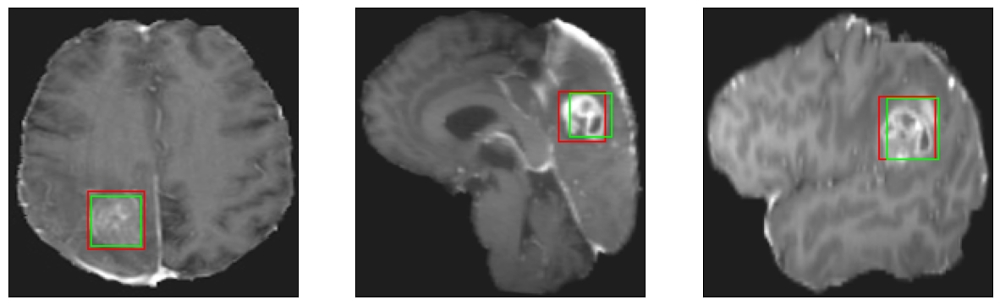

52/52 [==============================] - 8s 146ms/step - loss: 2.4426 - IoU: 0.7732 - val_loss: 4.2130 - val_IoU: 0.6929
Epoch 83/150
52/52 [==============================] - ETA: 0s - loss: 2.4282 - IoU: 0.7768
Epoch 83: val_loss did not improve from 4.12958
8/8 [==============================] - 0s 31ms/step


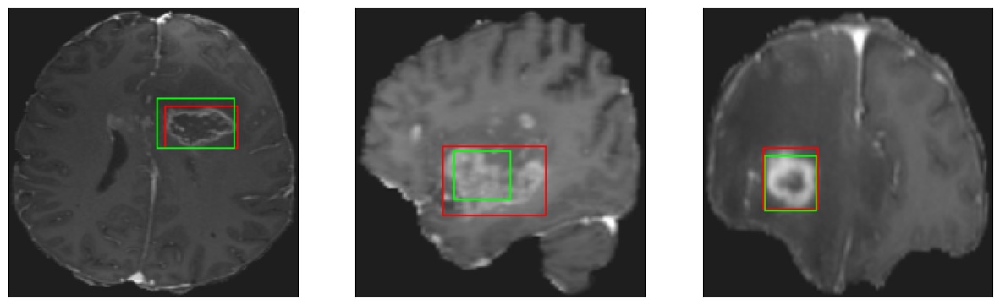

52/52 [==============================] - 6s 125ms/step - loss: 2.4282 - IoU: 0.7768 - val_loss: 4.4608 - val_IoU: 0.6897
Epoch 84/150
52/52 [==============================] - ETA: 0s - loss: 2.6372 - IoU: 0.7564
Epoch 84: val_loss did not improve from 4.12958
8/8 [==============================] - 0s 30ms/step


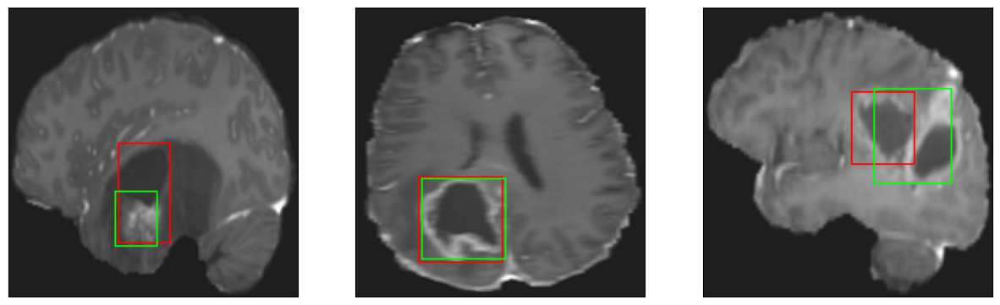

52/52 [==============================] - 7s 129ms/step - loss: 2.6372 - IoU: 0.7564 - val_loss: 4.5512 - val_IoU: 0.6846
Epoch 85/150
52/52 [==============================] - ETA: 0s - loss: 2.6773 - IoU: 0.7510
Epoch 85: val_loss improved from 4.12958 to 4.08000, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


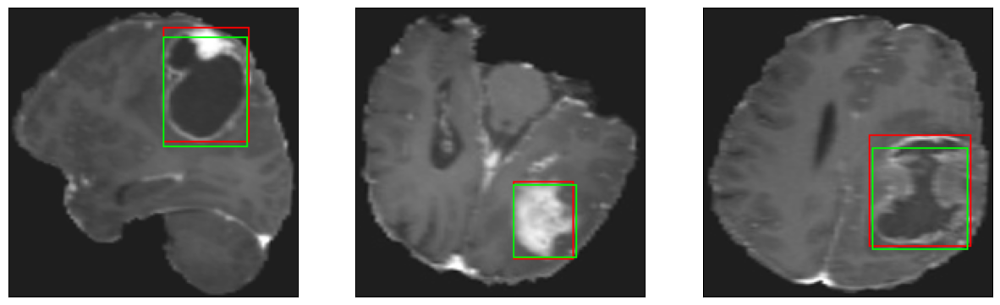

52/52 [==============================] - 9s 172ms/step - loss: 2.6773 - IoU: 0.7510 - val_loss: 4.0800 - val_IoU: 0.7133
Epoch 86/150
52/52 [==============================] - ETA: 0s - loss: 2.5151 - IoU: 0.7723
Epoch 86: val_loss did not improve from 4.08000
8/8 [==============================] - 0s 31ms/step


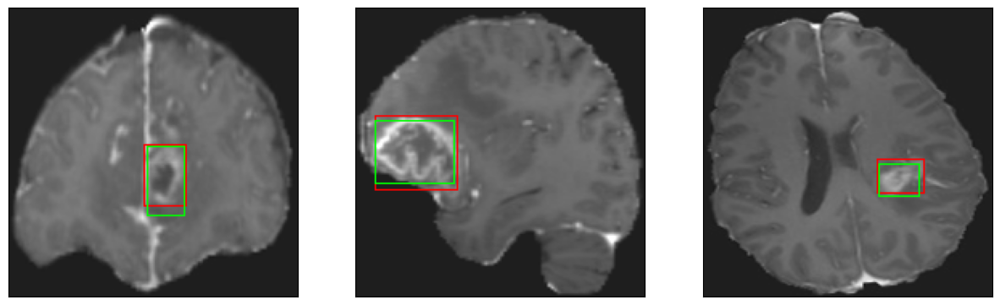

52/52 [==============================] - 7s 127ms/step - loss: 2.5151 - IoU: 0.7723 - val_loss: 4.3259 - val_IoU: 0.6993
Epoch 87/150
52/52 [==============================] - ETA: 0s - loss: 2.5207 - IoU: 0.7652
Epoch 87: val_loss improved from 4.08000 to 4.05991, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


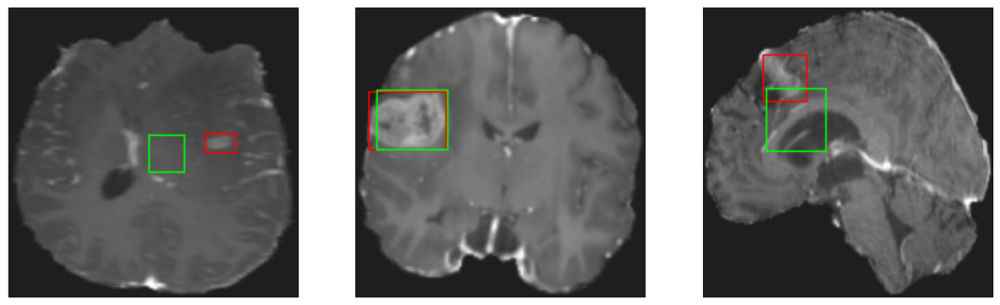

52/52 [==============================] - 10s 187ms/step - loss: 2.5207 - IoU: 0.7652 - val_loss: 4.0599 - val_IoU: 0.7076
Epoch 88/150
52/52 [==============================] - ETA: 0s - loss: 2.4678 - IoU: 0.7756
Epoch 88: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 30ms/step


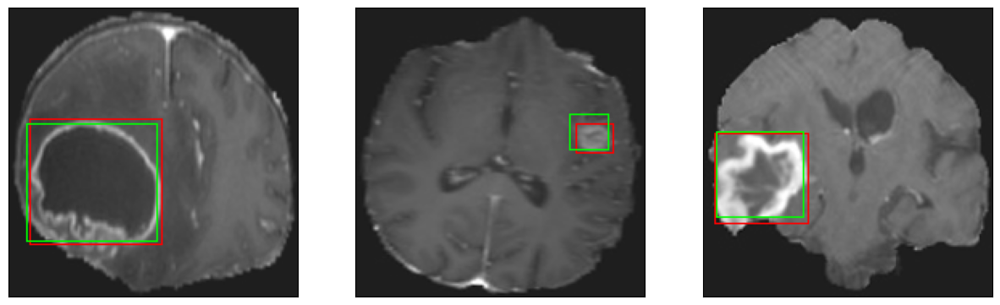

52/52 [==============================] - 7s 141ms/step - loss: 2.4678 - IoU: 0.7756 - val_loss: 4.4938 - val_IoU: 0.6683
Epoch 89/150
52/52 [==============================] - ETA: 0s - loss: 2.5247 - IoU: 0.7618
Epoch 89: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 31ms/step


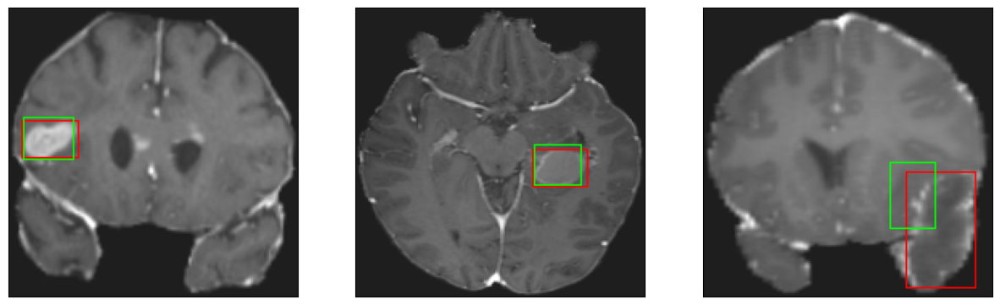

52/52 [==============================] - 7s 131ms/step - loss: 2.5247 - IoU: 0.7618 - val_loss: 4.4714 - val_IoU: 0.6748
Epoch 90/150
52/52 [==============================] - ETA: 0s - loss: 2.3182 - IoU: 0.7842
Epoch 90: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 31ms/step


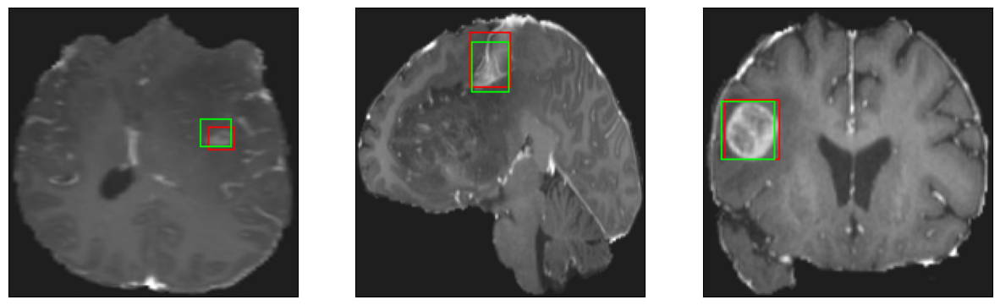

52/52 [==============================] - 7s 143ms/step - loss: 2.3182 - IoU: 0.7842 - val_loss: 4.0798 - val_IoU: 0.7154
Epoch 91/150
52/52 [==============================] - ETA: 0s - loss: 2.3621 - IoU: 0.7839
Epoch 91: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 34ms/step


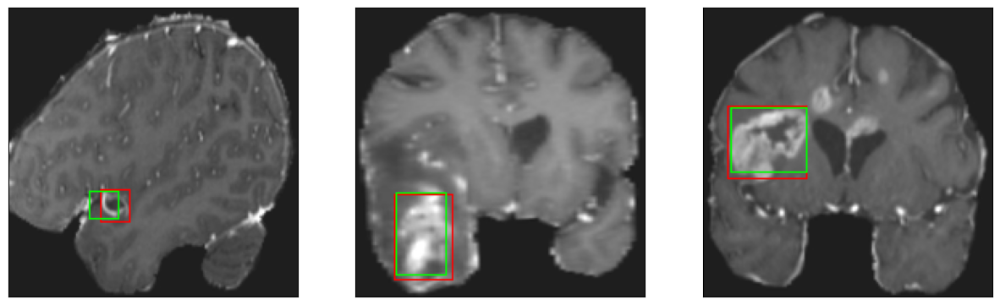

52/52 [==============================] - 7s 135ms/step - loss: 2.3621 - IoU: 0.7839 - val_loss: 4.1563 - val_IoU: 0.7030
Epoch 92/150
52/52 [==============================] - ETA: 0s - loss: 2.3383 - IoU: 0.7829
Epoch 92: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 31ms/step


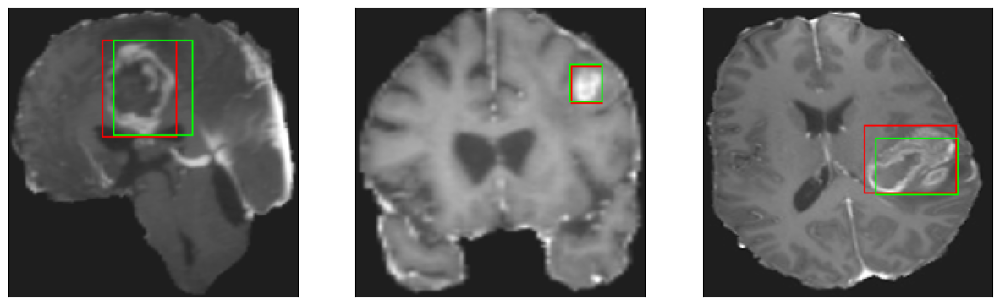

52/52 [==============================] - 7s 128ms/step - loss: 2.3383 - IoU: 0.7829 - val_loss: 4.2268 - val_IoU: 0.7082
Epoch 93/150
52/52 [==============================] - ETA: 0s - loss: 2.3804 - IoU: 0.7797
Epoch 93: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 34ms/step


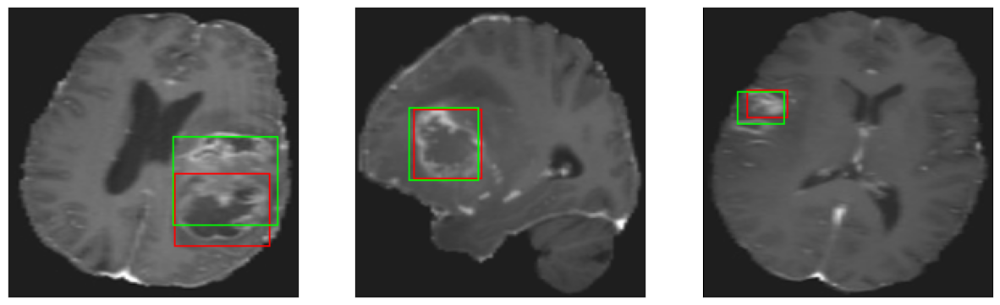

52/52 [==============================] - 7s 141ms/step - loss: 2.3804 - IoU: 0.7797 - val_loss: 4.6350 - val_IoU: 0.6468
Epoch 94/150
52/52 [==============================] - ETA: 0s - loss: 2.3728 - IoU: 0.7829
Epoch 94: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 31ms/step


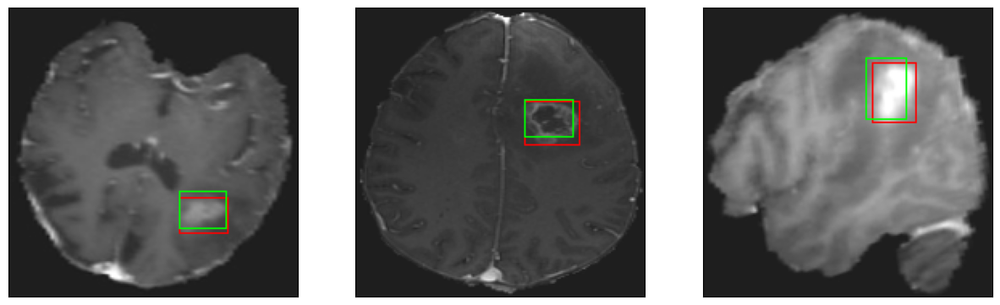

52/52 [==============================] - 7s 128ms/step - loss: 2.3728 - IoU: 0.7829 - val_loss: 4.1517 - val_IoU: 0.7013
Epoch 95/150
52/52 [==============================] - ETA: 0s - loss: 2.2625 - IoU: 0.7907
Epoch 95: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 31ms/step


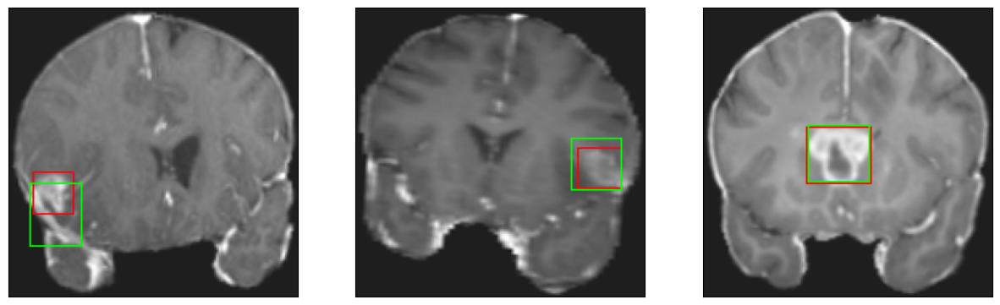

52/52 [==============================] - 7s 140ms/step - loss: 2.2625 - IoU: 0.7907 - val_loss: 4.1775 - val_IoU: 0.7093
Epoch 96/150
52/52 [==============================] - ETA: 0s - loss: 2.2882 - IoU: 0.7857
Epoch 96: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 33ms/step


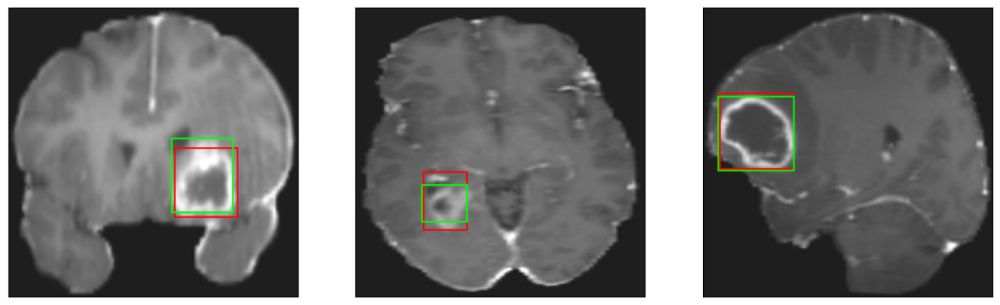

52/52 [==============================] - 8s 146ms/step - loss: 2.2882 - IoU: 0.7857 - val_loss: 4.4115 - val_IoU: 0.6855
Epoch 97/150
52/52 [==============================] - ETA: 0s - loss: 2.2123 - IoU: 0.7943
Epoch 97: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 31ms/step


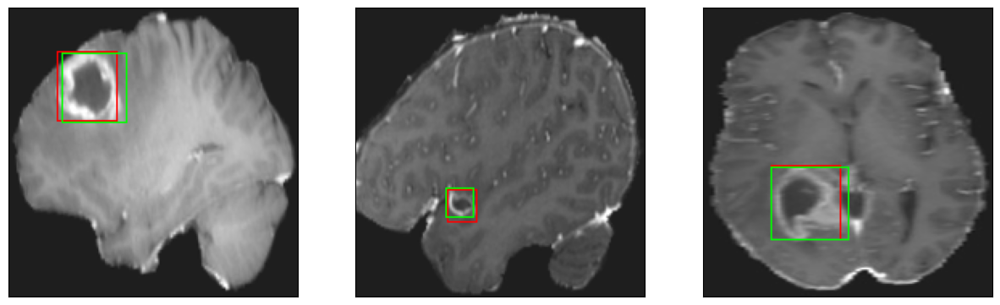

52/52 [==============================] - 7s 129ms/step - loss: 2.2123 - IoU: 0.7943 - val_loss: 4.1457 - val_IoU: 0.6996
Epoch 98/150
52/52 [==============================] - ETA: 0s - loss: 2.3839 - IoU: 0.7850
Epoch 98: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 30ms/step


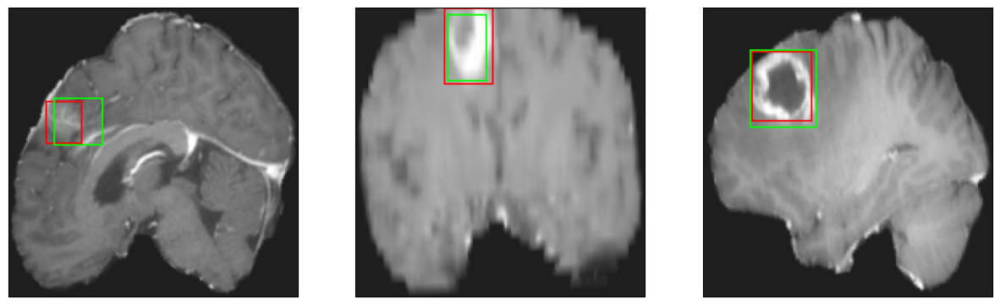

52/52 [==============================] - 8s 145ms/step - loss: 2.3839 - IoU: 0.7850 - val_loss: 4.4433 - val_IoU: 0.6850
Epoch 99/150
52/52 [==============================] - ETA: 0s - loss: 2.2503 - IoU: 0.7949
Epoch 99: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 31ms/step


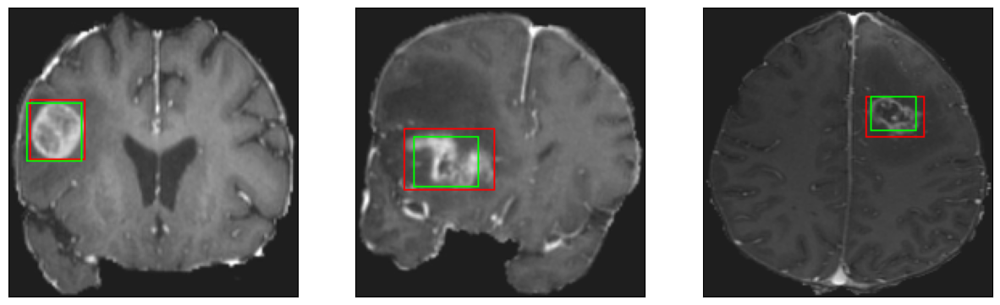

52/52 [==============================] - 7s 126ms/step - loss: 2.2503 - IoU: 0.7949 - val_loss: 4.1319 - val_IoU: 0.7056
Epoch 100/150
52/52 [==============================] - ETA: 0s - loss: 2.2393 - IoU: 0.7945
Epoch 100: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 31ms/step


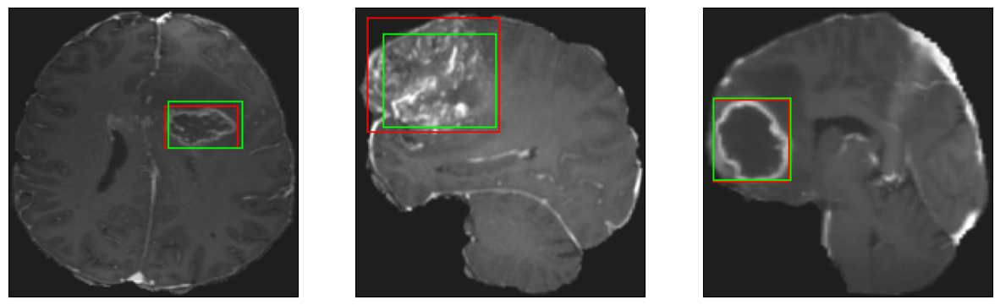

52/52 [==============================] - 7s 133ms/step - loss: 2.2393 - IoU: 0.7945 - val_loss: 4.4348 - val_IoU: 0.6750
Epoch 101/150
52/52 [==============================] - ETA: 0s - loss: 2.3739 - IoU: 0.7803
Epoch 101: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 30ms/step


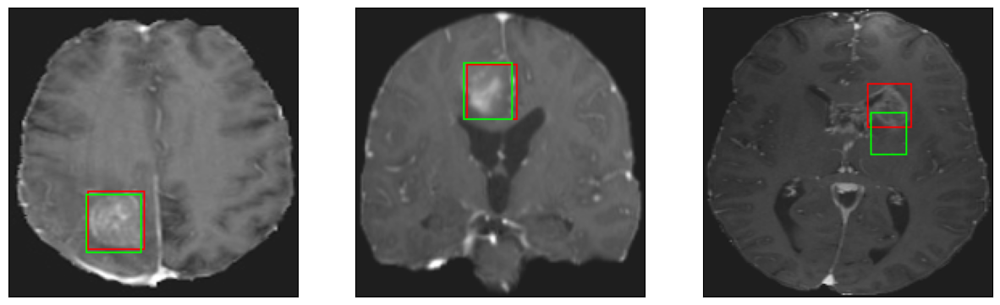

52/52 [==============================] - 7s 143ms/step - loss: 2.3739 - IoU: 0.7803 - val_loss: 4.1511 - val_IoU: 0.7092
Epoch 102/150
52/52 [==============================] - ETA: 0s - loss: 2.3715 - IoU: 0.7781
Epoch 102: val_loss did not improve from 4.05991
8/8 [==============================] - 0s 31ms/step


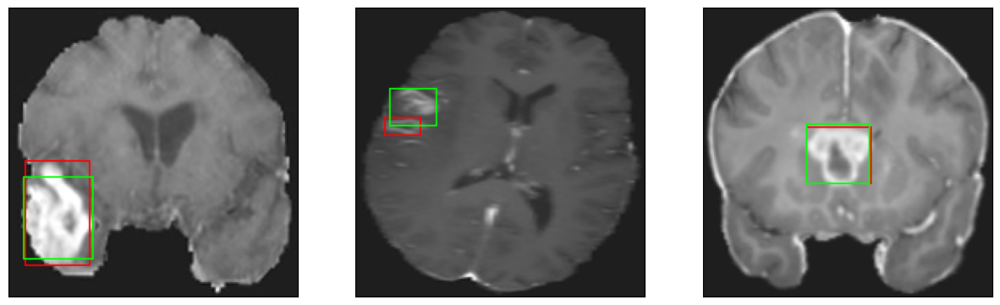

52/52 [==============================] - 7s 128ms/step - loss: 2.3715 - IoU: 0.7781 - val_loss: 4.1808 - val_IoU: 0.7091
Epoch 103/150
52/52 [==============================] - ETA: 0s - loss: 2.1790 - IoU: 0.8046
Epoch 103: val_loss improved from 4.05991 to 4.03362, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


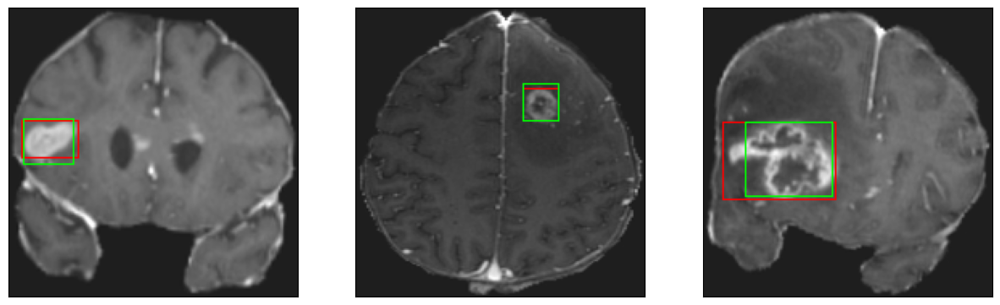

52/52 [==============================] - 10s 184ms/step - loss: 2.1790 - IoU: 0.8046 - val_loss: 4.0336 - val_IoU: 0.7191
Epoch 104/150
52/52 [==============================] - ETA: 0s - loss: 2.2714 - IoU: 0.7889
Epoch 104: val_loss did not improve from 4.03362
8/8 [==============================] - 0s 36ms/step


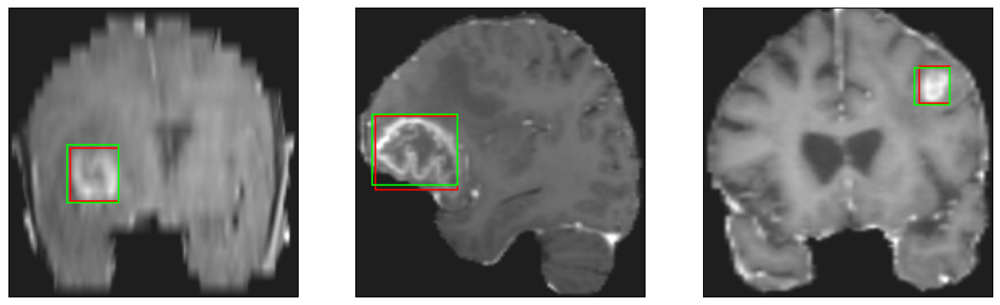

52/52 [==============================] - 7s 139ms/step - loss: 2.2714 - IoU: 0.7889 - val_loss: 4.2718 - val_IoU: 0.6943
Epoch 105/150
52/52 [==============================] - ETA: 0s - loss: 2.3286 - IoU: 0.7890
Epoch 105: val_loss did not improve from 4.03362
8/8 [==============================] - 0s 31ms/step


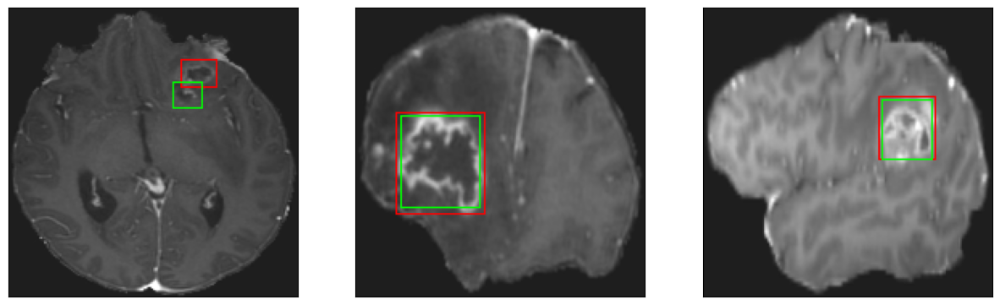

52/52 [==============================] - 7s 131ms/step - loss: 2.3286 - IoU: 0.7890 - val_loss: 4.3033 - val_IoU: 0.6914
Epoch 106/150
52/52 [==============================] - ETA: 0s - loss: 2.3499 - IoU: 0.7874
Epoch 106: val_loss did not improve from 4.03362
8/8 [==============================] - 0s 31ms/step


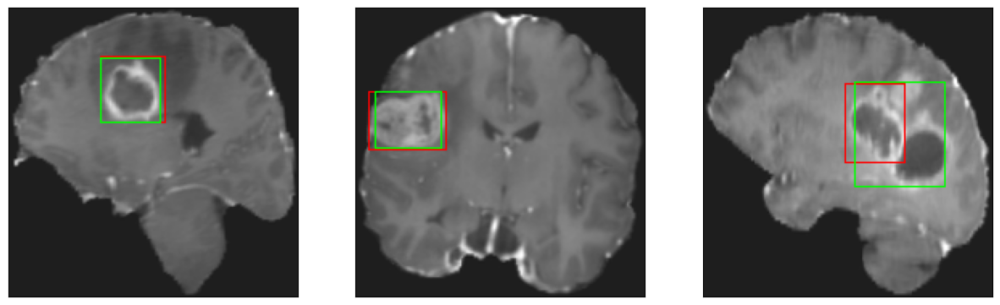

52/52 [==============================] - 8s 144ms/step - loss: 2.3499 - IoU: 0.7874 - val_loss: 4.0951 - val_IoU: 0.7161
Epoch 107/150
52/52 [==============================] - ETA: 0s - loss: 2.2340 - IoU: 0.7998
Epoch 107: val_loss did not improve from 4.03362
8/8 [==============================] - 0s 31ms/step


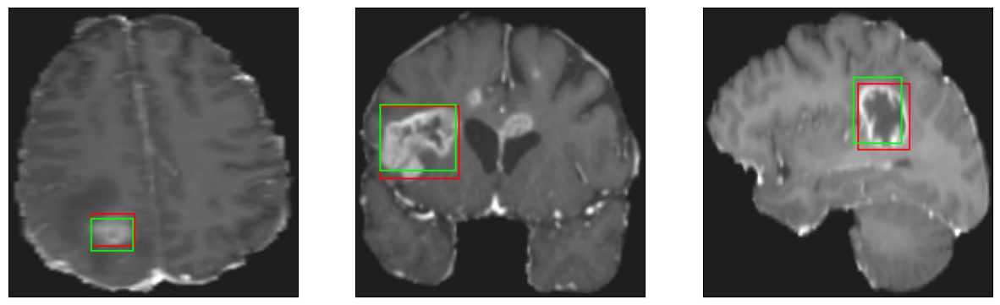

52/52 [==============================] - 7s 138ms/step - loss: 2.2340 - IoU: 0.7998 - val_loss: 4.4235 - val_IoU: 0.6711
Epoch 108/150
52/52 [==============================] - ETA: 0s - loss: 2.2899 - IoU: 0.7962
Epoch 108: val_loss did not improve from 4.03362
8/8 [==============================] - 0s 32ms/step


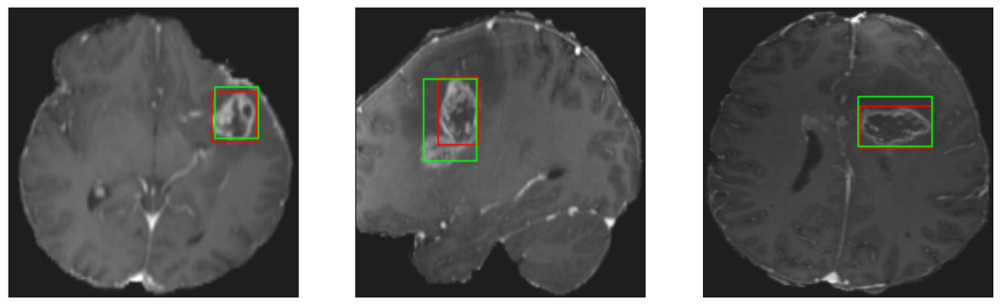

52/52 [==============================] - 7s 132ms/step - loss: 2.2899 - IoU: 0.7962 - val_loss: 4.2107 - val_IoU: 0.7065
Epoch 109/150
52/52 [==============================] - ETA: 0s - loss: 2.2810 - IoU: 0.7872
Epoch 109: val_loss did not improve from 4.03362
8/8 [==============================] - 0s 31ms/step


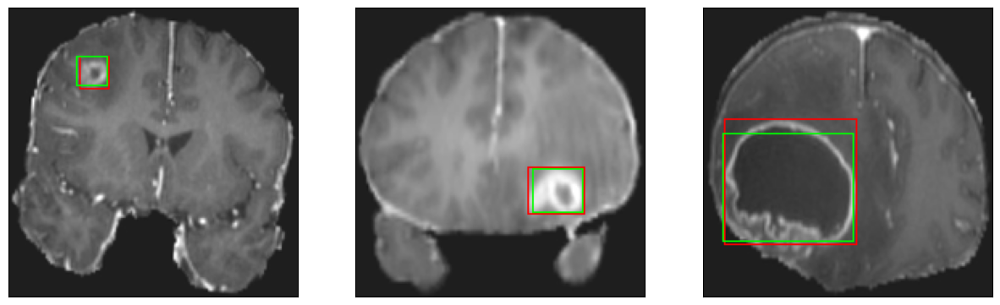

52/52 [==============================] - 8s 151ms/step - loss: 2.2810 - IoU: 0.7872 - val_loss: 4.1819 - val_IoU: 0.7153
Epoch 110/150
52/52 [==============================] - ETA: 0s - loss: 2.2687 - IoU: 0.7871
Epoch 110: val_loss did not improve from 4.03362
8/8 [==============================] - 0s 31ms/step


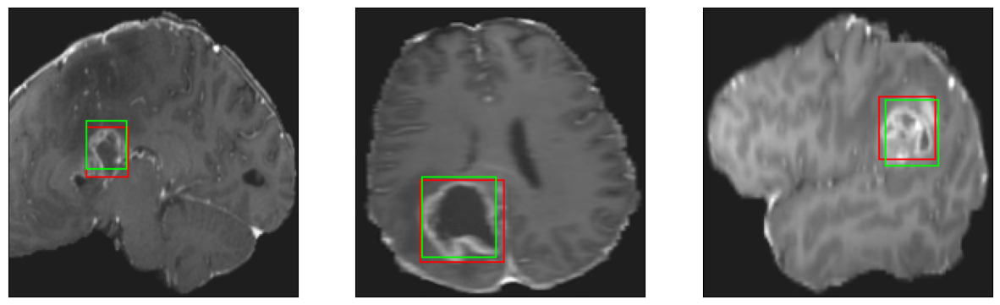

52/52 [==============================] - 7s 130ms/step - loss: 2.2687 - IoU: 0.7871 - val_loss: 4.3112 - val_IoU: 0.6987
Epoch 111/150
52/52 [==============================] - ETA: 0s - loss: 2.2320 - IoU: 0.7899
Epoch 111: val_loss did not improve from 4.03362
8/8 [==============================] - 0s 31ms/step


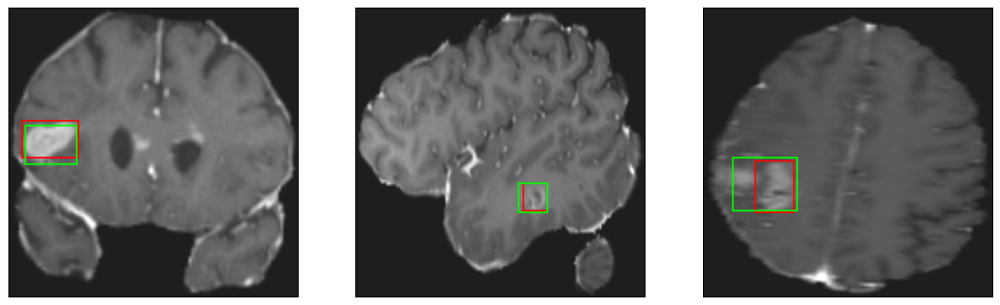

52/52 [==============================] - 7s 136ms/step - loss: 2.2320 - IoU: 0.7899 - val_loss: 4.0847 - val_IoU: 0.7186
Epoch 112/150
52/52 [==============================] - ETA: 0s - loss: 2.2294 - IoU: 0.7935
Epoch 112: val_loss did not improve from 4.03362
8/8 [==============================] - 0s 31ms/step


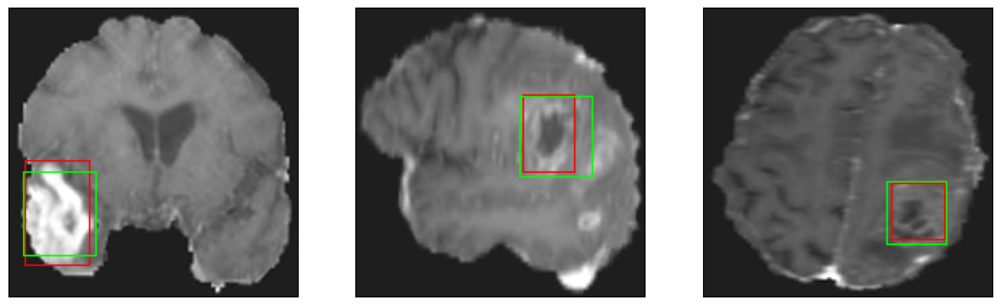

52/52 [==============================] - 7s 129ms/step - loss: 2.2294 - IoU: 0.7935 - val_loss: 4.3306 - val_IoU: 0.7006
Epoch 113/150
52/52 [==============================] - ETA: 0s - loss: 2.1657 - IoU: 0.8040
Epoch 113: val_loss improved from 4.03362 to 3.98270, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


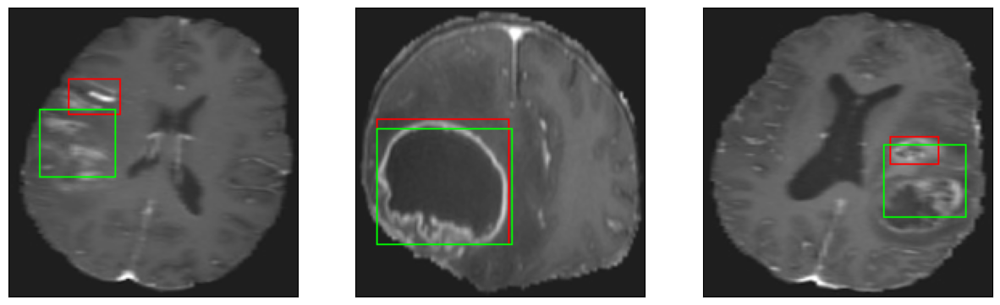

52/52 [==============================] - 9s 173ms/step - loss: 2.1657 - IoU: 0.8040 - val_loss: 3.9827 - val_IoU: 0.7245
Epoch 114/150
52/52 [==============================] - ETA: 0s - loss: 2.1370 - IoU: 0.8015
Epoch 114: val_loss did not improve from 3.98270
8/8 [==============================] - 0s 32ms/step


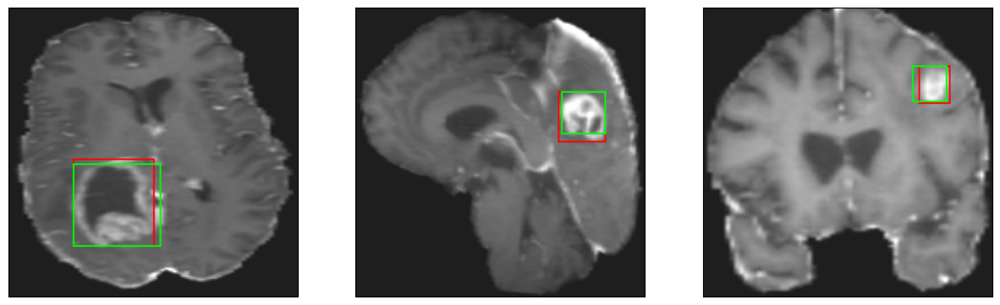

52/52 [==============================] - 8s 150ms/step - loss: 2.1370 - IoU: 0.8015 - val_loss: 3.9921 - val_IoU: 0.7186
Epoch 115/150
52/52 [==============================] - ETA: 0s - loss: 2.2678 - IoU: 0.7881
Epoch 115: val_loss did not improve from 3.98270
8/8 [==============================] - 0s 32ms/step


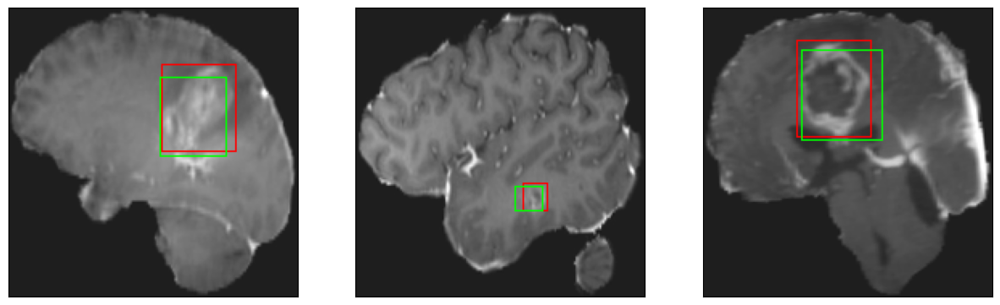

52/52 [==============================] - 7s 131ms/step - loss: 2.2678 - IoU: 0.7881 - val_loss: 4.6690 - val_IoU: 0.6668
Epoch 116/150
52/52 [==============================] - ETA: 0s - loss: 2.2496 - IoU: 0.7923
Epoch 116: val_loss did not improve from 3.98270
8/8 [==============================] - 0s 32ms/step


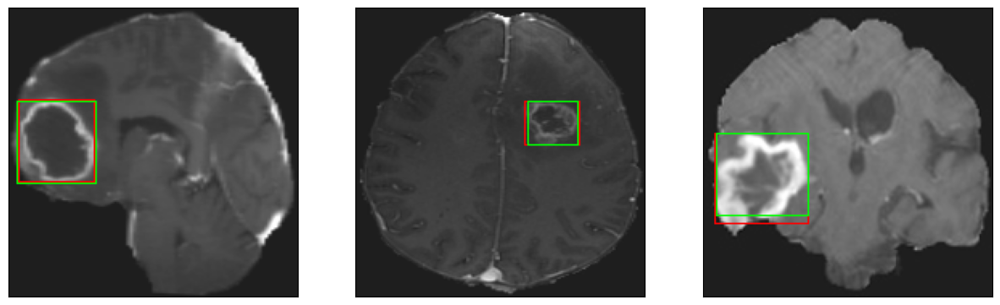

52/52 [==============================] - 8s 152ms/step - loss: 2.2496 - IoU: 0.7923 - val_loss: 4.2931 - val_IoU: 0.7135
Epoch 117/150
52/52 [==============================] - ETA: 0s - loss: 2.0847 - IoU: 0.8102
Epoch 117: val_loss did not improve from 3.98270
8/8 [==============================] - 0s 30ms/step


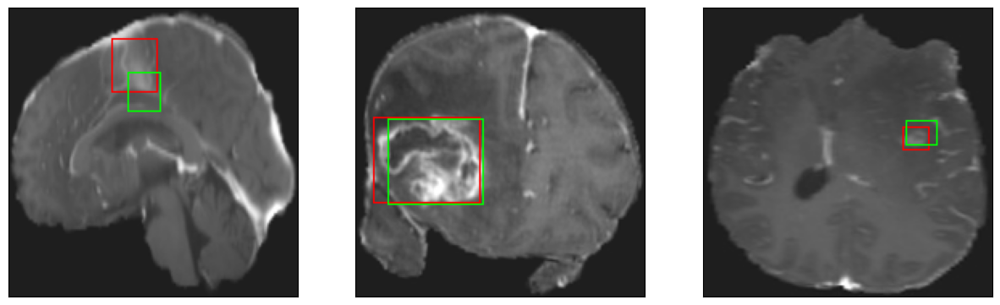

52/52 [==============================] - 7s 128ms/step - loss: 2.0847 - IoU: 0.8102 - val_loss: 4.1442 - val_IoU: 0.7099
Epoch 118/150
52/52 [==============================] - ETA: 0s - loss: 2.2180 - IoU: 0.7884
Epoch 118: val_loss did not improve from 3.98270
8/8 [==============================] - 0s 30ms/step


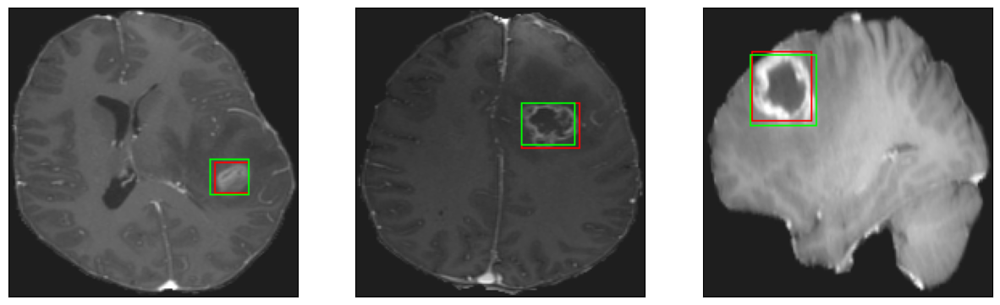

52/52 [==============================] - 7s 131ms/step - loss: 2.2180 - IoU: 0.7884 - val_loss: 4.0835 - val_IoU: 0.7087
Epoch 119/150
52/52 [==============================] - ETA: 0s - loss: 2.2739 - IoU: 0.7851
Epoch 119: val_loss did not improve from 3.98270
8/8 [==============================] - 0s 31ms/step


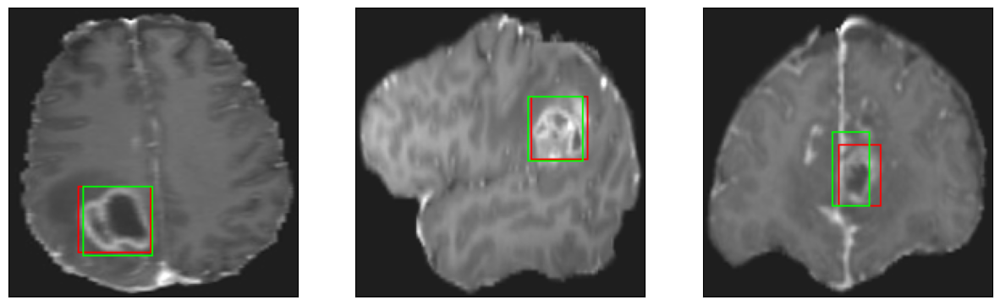

52/52 [==============================] - 7s 127ms/step - loss: 2.2739 - IoU: 0.7851 - val_loss: 4.4050 - val_IoU: 0.6856
Epoch 120/150
52/52 [==============================] - ETA: 0s - loss: 2.1654 - IoU: 0.7985
Epoch 120: val_loss did not improve from 3.98270
8/8 [==============================] - 0s 32ms/step


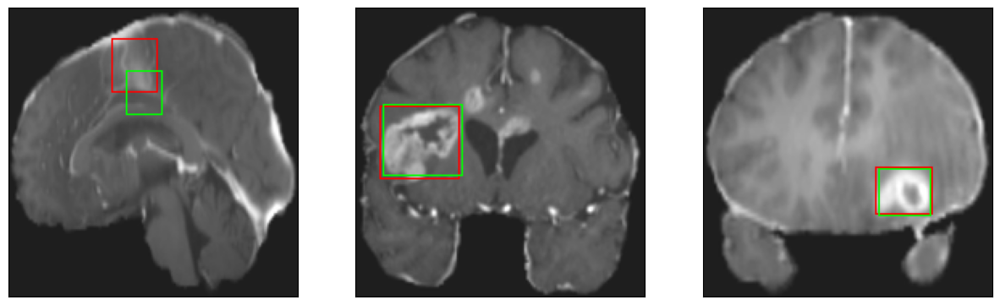

52/52 [==============================] - 7s 136ms/step - loss: 2.1654 - IoU: 0.7985 - val_loss: 4.0747 - val_IoU: 0.7177
Epoch 121/150
52/52 [==============================] - ETA: 0s - loss: 2.0830 - IoU: 0.8085
Epoch 121: val_loss did not improve from 3.98270
8/8 [==============================] - 0s 31ms/step


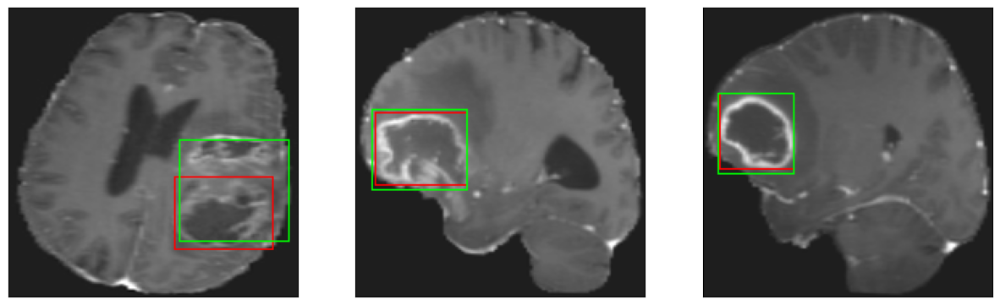

52/52 [==============================] - 7s 132ms/step - loss: 2.0830 - IoU: 0.8085 - val_loss: 4.2396 - val_IoU: 0.7078
Epoch 122/150
52/52 [==============================] - ETA: 0s - loss: 2.1647 - IoU: 0.8002
Epoch 122: val_loss did not improve from 3.98270
8/8 [==============================] - 0s 33ms/step


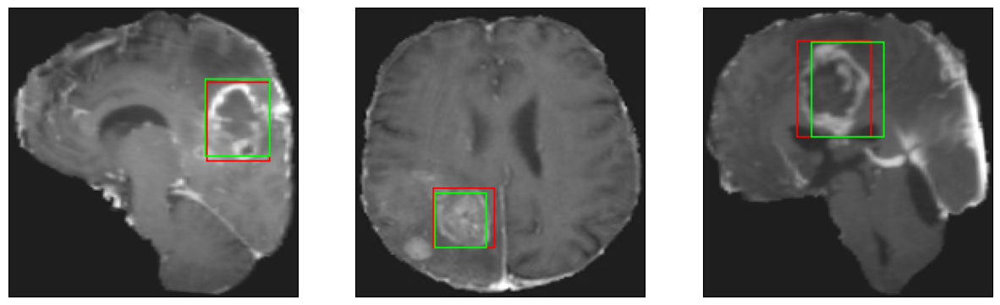

52/52 [==============================] - 7s 141ms/step - loss: 2.1647 - IoU: 0.8002 - val_loss: 4.0944 - val_IoU: 0.7131
Epoch 123/150
52/52 [==============================] - ETA: 0s - loss: 2.0992 - IoU: 0.8083
Epoch 123: val_loss did not improve from 3.98270
8/8 [==============================] - 0s 30ms/step


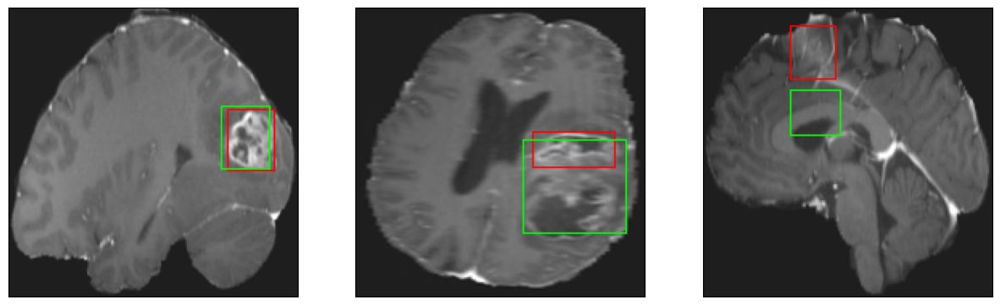

52/52 [==============================] - 7s 129ms/step - loss: 2.0992 - IoU: 0.8083 - val_loss: 4.2640 - val_IoU: 0.6998
Epoch 124/150
52/52 [==============================] - ETA: 0s - loss: 2.0584 - IoU: 0.8140
Epoch 124: val_loss improved from 3.98270 to 3.97314, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


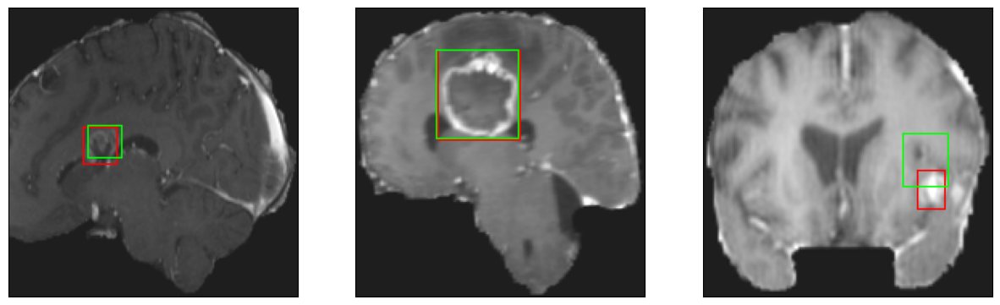

52/52 [==============================] - 9s 176ms/step - loss: 2.0584 - IoU: 0.8140 - val_loss: 3.9731 - val_IoU: 0.7297
Epoch 125/150
52/52 [==============================] - ETA: 0s - loss: 2.1262 - IoU: 0.8118
Epoch 125: val_loss did not improve from 3.97314
8/8 [==============================] - 0s 33ms/step


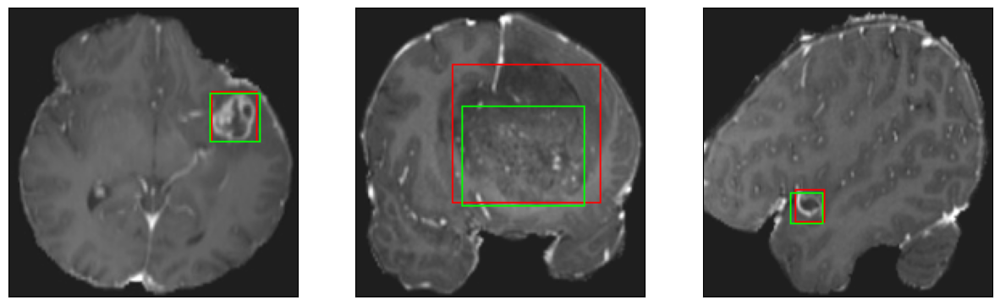

52/52 [==============================] - 7s 143ms/step - loss: 2.1262 - IoU: 0.8118 - val_loss: 4.2159 - val_IoU: 0.7133
Epoch 126/150
52/52 [==============================] - ETA: 0s - loss: 2.0260 - IoU: 0.8157
Epoch 126: val_loss did not improve from 3.97314
8/8 [==============================] - 0s 31ms/step


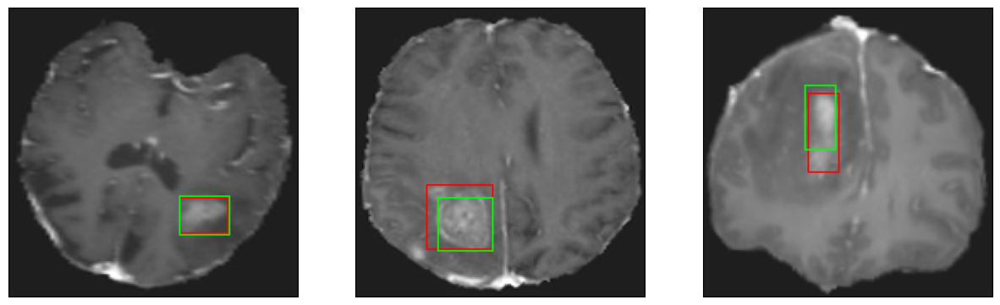

52/52 [==============================] - 7s 129ms/step - loss: 2.0260 - IoU: 0.8157 - val_loss: 4.1132 - val_IoU: 0.7173
Epoch 127/150
52/52 [==============================] - ETA: 0s - loss: 2.1198 - IoU: 0.8070
Epoch 127: val_loss improved from 3.97314 to 3.88985, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 33ms/step


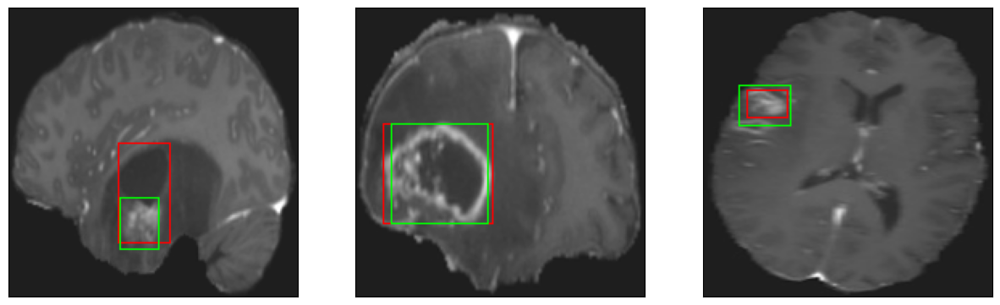

52/52 [==============================] - 10s 191ms/step - loss: 2.1198 - IoU: 0.8070 - val_loss: 3.8899 - val_IoU: 0.7266
Epoch 128/150
52/52 [==============================] - ETA: 0s - loss: 2.0601 - IoU: 0.8160
Epoch 128: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


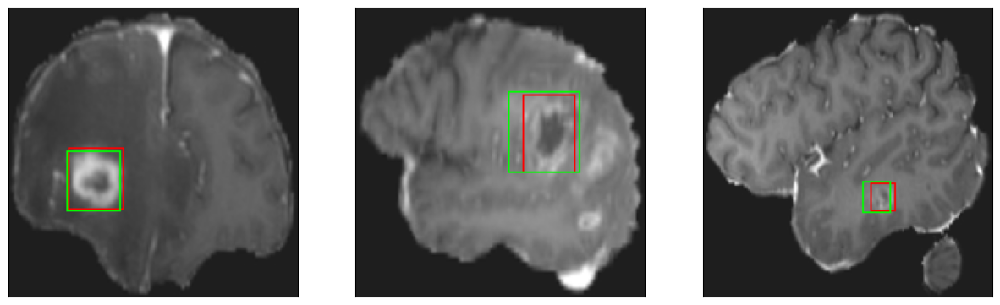

52/52 [==============================] - 7s 135ms/step - loss: 2.0601 - IoU: 0.8160 - val_loss: 4.1902 - val_IoU: 0.6933
Epoch 129/150
52/52 [==============================] - ETA: 0s - loss: 2.1366 - IoU: 0.8058
Epoch 129: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 33ms/step


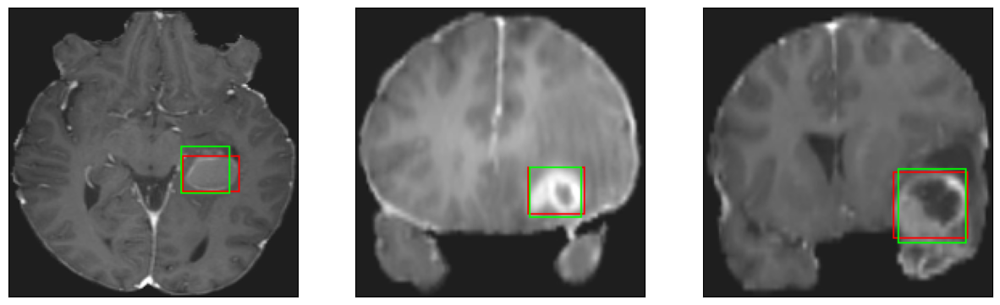

52/52 [==============================] - 8s 145ms/step - loss: 2.1366 - IoU: 0.8058 - val_loss: 4.2637 - val_IoU: 0.7084
Epoch 130/150
52/52 [==============================] - ETA: 0s - loss: 2.2096 - IoU: 0.7993
Epoch 130: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


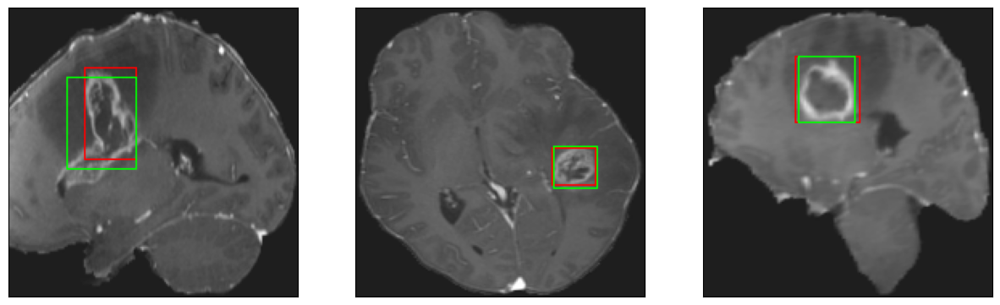

52/52 [==============================] - 7s 128ms/step - loss: 2.2096 - IoU: 0.7993 - val_loss: 4.1360 - val_IoU: 0.7104
Epoch 131/150
52/52 [==============================] - ETA: 0s - loss: 2.0957 - IoU: 0.8051
Epoch 131: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


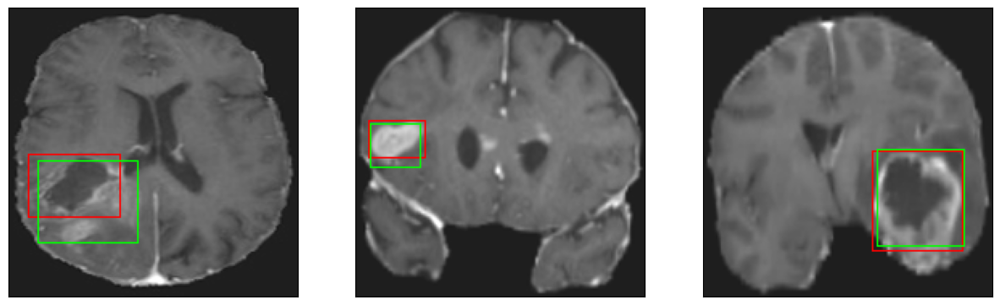

52/52 [==============================] - 7s 139ms/step - loss: 2.0957 - IoU: 0.8051 - val_loss: 4.1565 - val_IoU: 0.7074
Epoch 132/150
52/52 [==============================] - ETA: 0s - loss: 2.1039 - IoU: 0.8095
Epoch 132: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 32ms/step


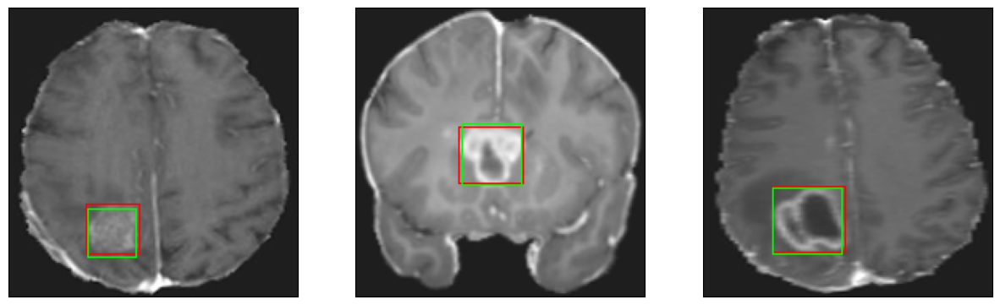

52/52 [==============================] - 7s 130ms/step - loss: 2.1039 - IoU: 0.8095 - val_loss: 3.9916 - val_IoU: 0.7292
Epoch 133/150
52/52 [==============================] - ETA: 0s - loss: 2.0900 - IoU: 0.8096
Epoch 133: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 32ms/step


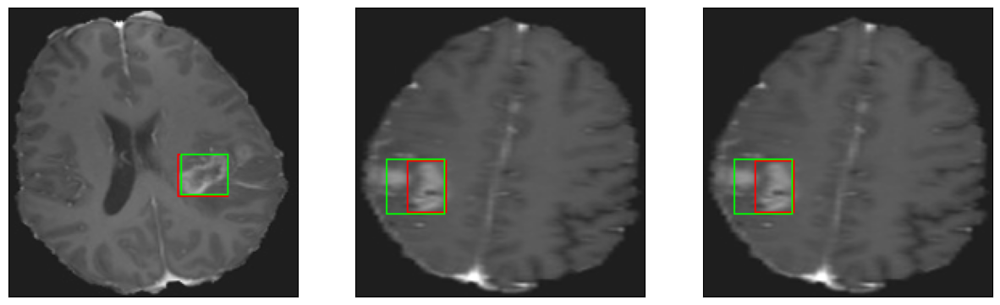

52/52 [==============================] - 7s 130ms/step - loss: 2.0900 - IoU: 0.8096 - val_loss: 4.1012 - val_IoU: 0.7190
Epoch 134/150
52/52 [==============================] - ETA: 0s - loss: 2.0579 - IoU: 0.8055
Epoch 134: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


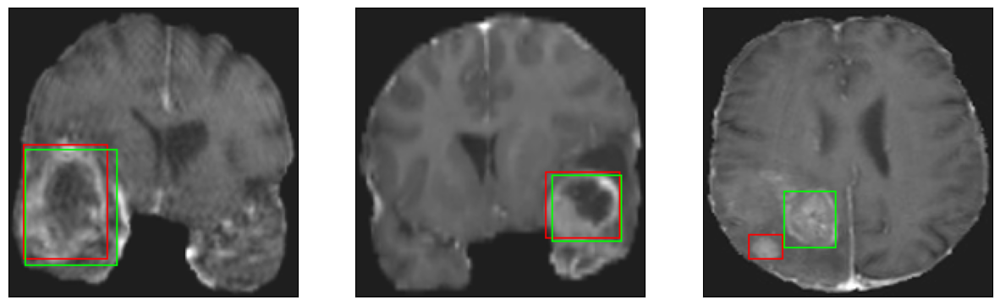

52/52 [==============================] - 7s 130ms/step - loss: 2.0579 - IoU: 0.8055 - val_loss: 4.0036 - val_IoU: 0.7237
Epoch 135/150
52/52 [==============================] - ETA: 0s - loss: 1.9934 - IoU: 0.8239
Epoch 135: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


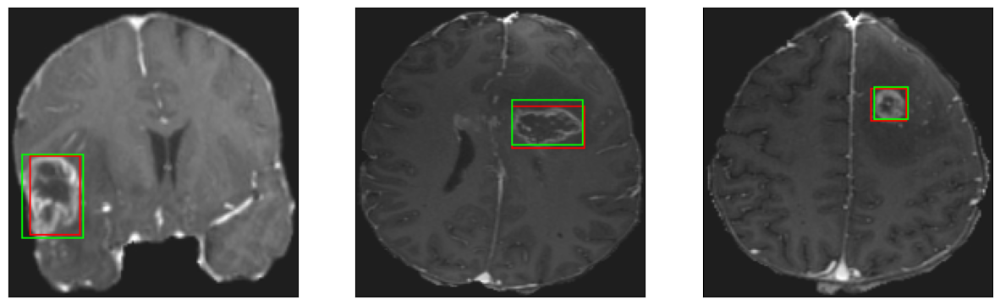

52/52 [==============================] - 7s 135ms/step - loss: 1.9934 - IoU: 0.8239 - val_loss: 4.1981 - val_IoU: 0.7216
Epoch 136/150
52/52 [==============================] - ETA: 0s - loss: 2.0056 - IoU: 0.8111
Epoch 136: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 30ms/step


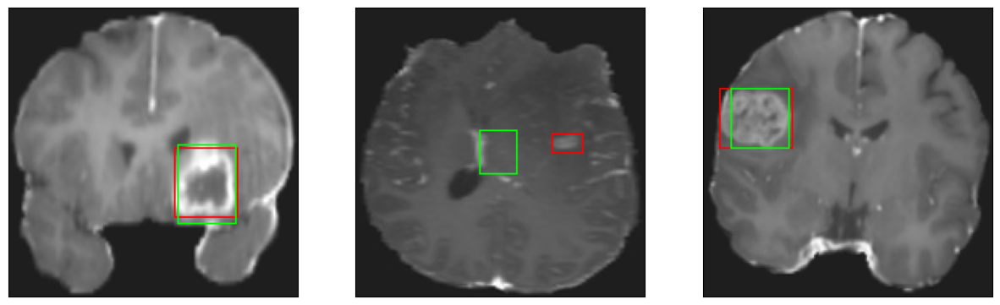

52/52 [==============================] - 7s 135ms/step - loss: 2.0056 - IoU: 0.8111 - val_loss: 4.1573 - val_IoU: 0.7147
Epoch 137/150
52/52 [==============================] - ETA: 0s - loss: 2.1996 - IoU: 0.7917
Epoch 137: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 34ms/step


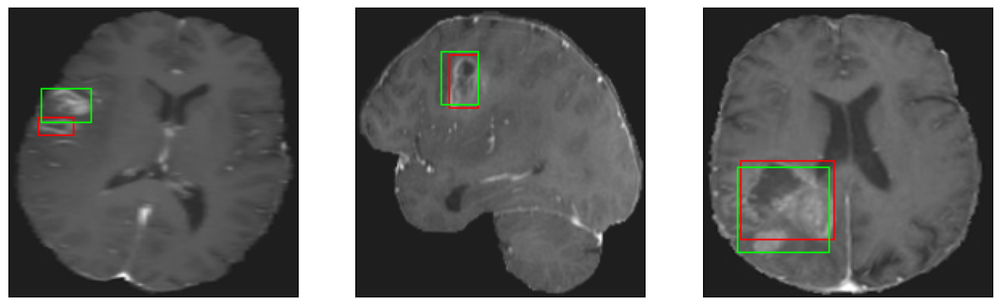

52/52 [==============================] - 7s 133ms/step - loss: 2.1996 - IoU: 0.7917 - val_loss: 4.3997 - val_IoU: 0.6796
Epoch 138/150
52/52 [==============================] - ETA: 0s - loss: 2.0982 - IoU: 0.8082
Epoch 138: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


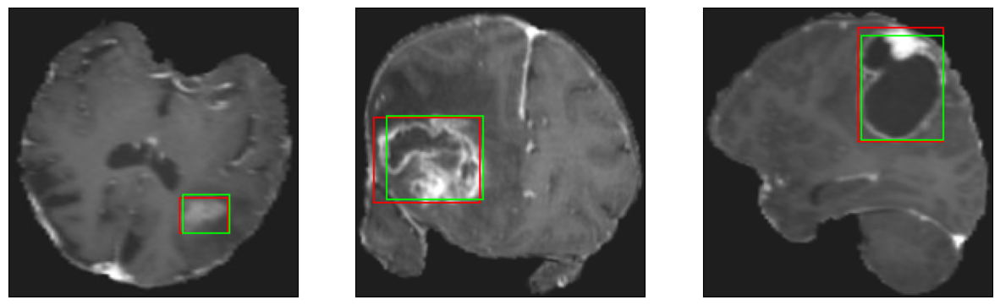

52/52 [==============================] - 7s 131ms/step - loss: 2.0982 - IoU: 0.8082 - val_loss: 4.2581 - val_IoU: 0.6900
Epoch 139/150
52/52 [==============================] - ETA: 0s - loss: 2.0576 - IoU: 0.8037
Epoch 139: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 32ms/step


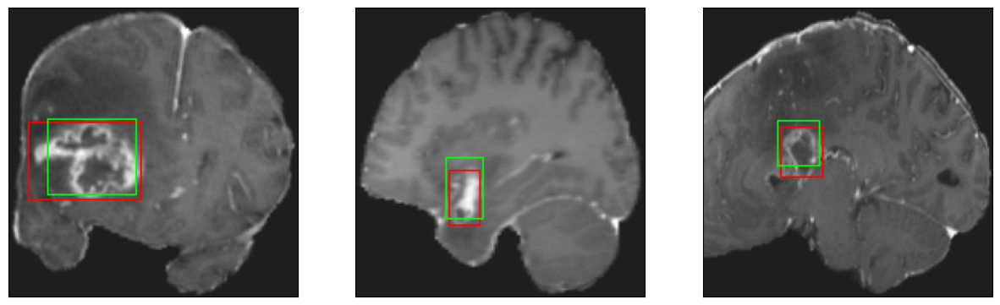

52/52 [==============================] - 7s 130ms/step - loss: 2.0576 - IoU: 0.8037 - val_loss: 4.3228 - val_IoU: 0.6818
Epoch 140/150
52/52 [==============================] - ETA: 0s - loss: 1.9938 - IoU: 0.8105
Epoch 140: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


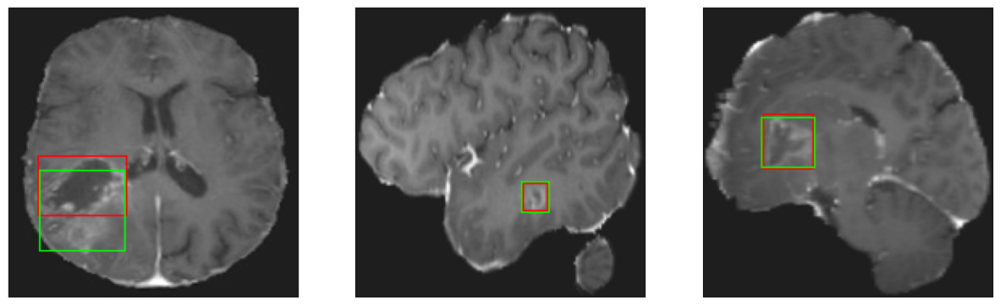

52/52 [==============================] - 7s 142ms/step - loss: 1.9938 - IoU: 0.8105 - val_loss: 4.0848 - val_IoU: 0.7234
Epoch 141/150
52/52 [==============================] - ETA: 0s - loss: 2.0671 - IoU: 0.8127
Epoch 141: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


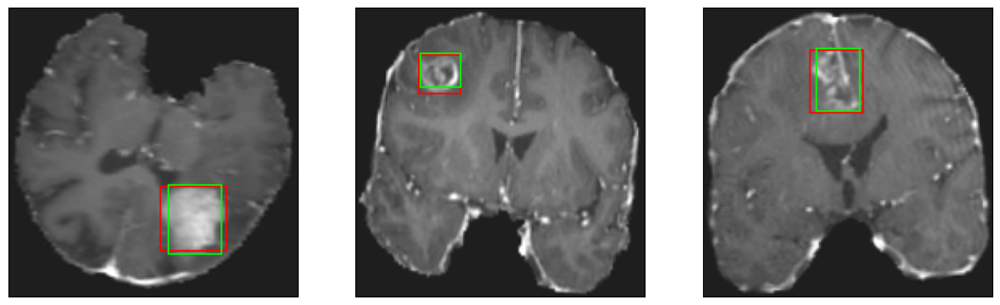

52/52 [==============================] - 7s 129ms/step - loss: 2.0671 - IoU: 0.8127 - val_loss: 3.9043 - val_IoU: 0.7343
Epoch 142/150
52/52 [==============================] - ETA: 0s - loss: 2.0989 - IoU: 0.8107
Epoch 142: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


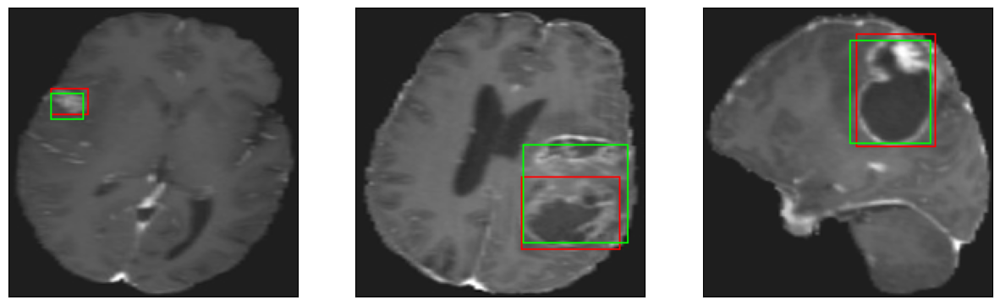

52/52 [==============================] - 7s 130ms/step - loss: 2.0989 - IoU: 0.8107 - val_loss: 4.1086 - val_IoU: 0.6914
Epoch 143/150
52/52 [==============================] - ETA: 0s - loss: 2.0171 - IoU: 0.8196
Epoch 143: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


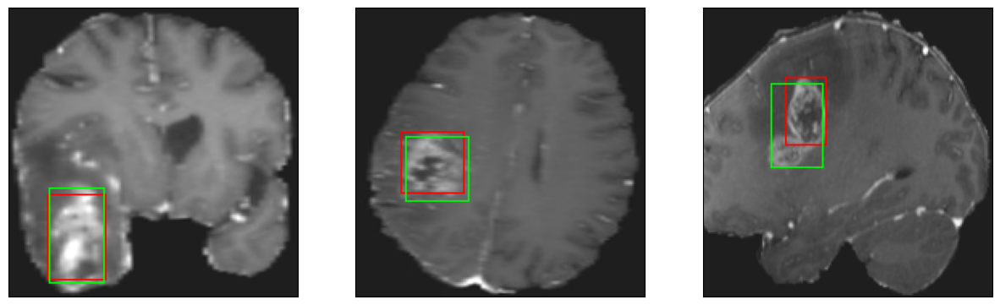

52/52 [==============================] - 7s 134ms/step - loss: 2.0171 - IoU: 0.8196 - val_loss: 4.0425 - val_IoU: 0.7172
Epoch 144/150
52/52 [==============================] - ETA: 0s - loss: 2.1011 - IoU: 0.8095
Epoch 144: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 32ms/step


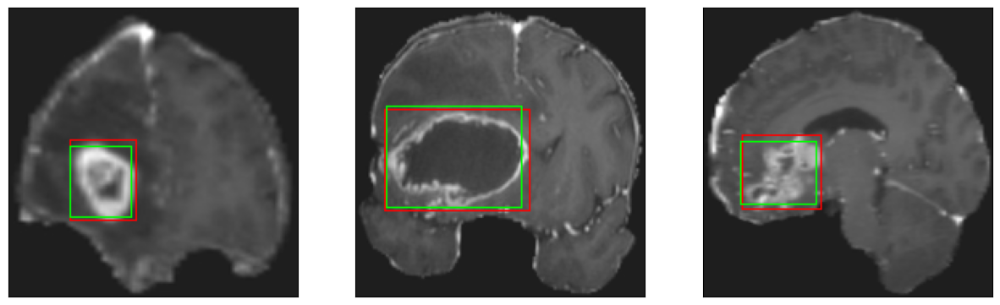

52/52 [==============================] - 7s 127ms/step - loss: 2.1011 - IoU: 0.8095 - val_loss: 4.5155 - val_IoU: 0.6656
Epoch 145/150
52/52 [==============================] - ETA: 0s - loss: 2.0835 - IoU: 0.8083
Epoch 145: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 30ms/step


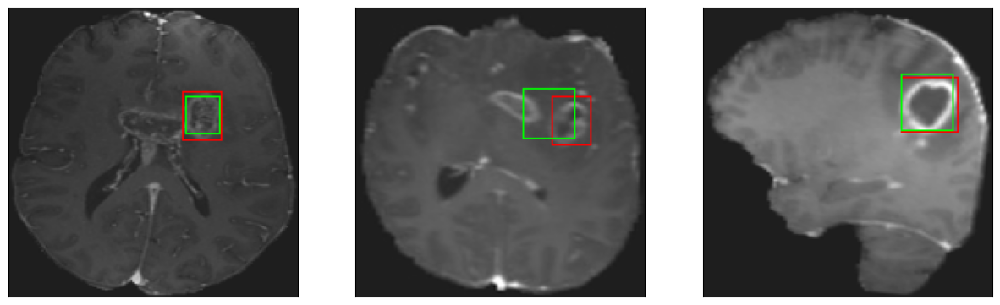

52/52 [==============================] - 8s 155ms/step - loss: 2.0835 - IoU: 0.8083 - val_loss: 3.9237 - val_IoU: 0.7348
Epoch 146/150
52/52 [==============================] - ETA: 0s - loss: 1.9948 - IoU: 0.8201
Epoch 146: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 30ms/step


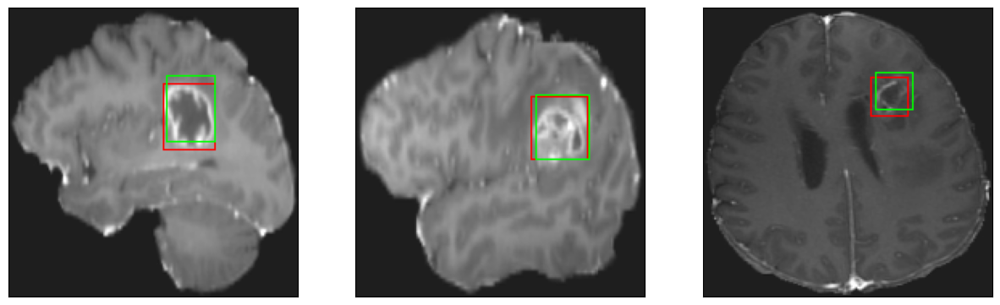

52/52 [==============================] - 7s 128ms/step - loss: 1.9948 - IoU: 0.8201 - val_loss: 4.3287 - val_IoU: 0.6916
Epoch 147/150
52/52 [==============================] - ETA: 0s - loss: 2.0242 - IoU: 0.8157
Epoch 147: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


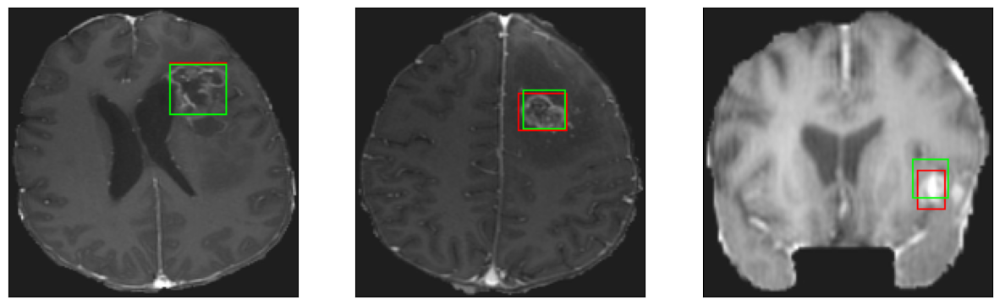

52/52 [==============================] - 6s 123ms/step - loss: 2.0242 - IoU: 0.8157 - val_loss: 4.0738 - val_IoU: 0.7159
Epoch 148/150
52/52 [==============================] - ETA: 0s - loss: 2.0727 - IoU: 0.8121
Epoch 148: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


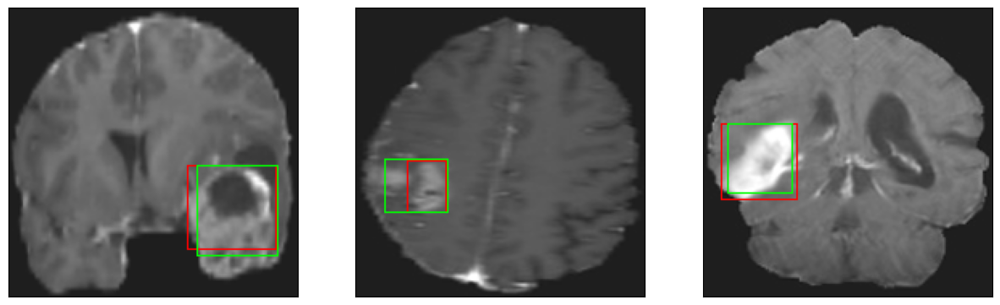

52/52 [==============================] - 7s 129ms/step - loss: 2.0727 - IoU: 0.8121 - val_loss: 4.1442 - val_IoU: 0.7199
Epoch 149/150
52/52 [==============================] - ETA: 0s - loss: 1.9598 - IoU: 0.8230
Epoch 149: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 31ms/step


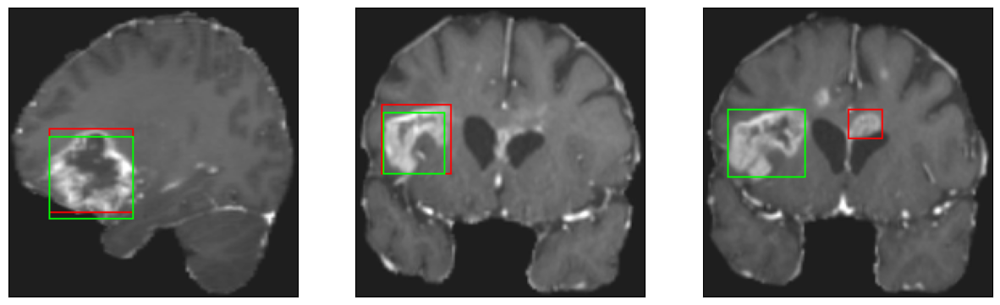

52/52 [==============================] - 6s 125ms/step - loss: 1.9598 - IoU: 0.8230 - val_loss: 3.9873 - val_IoU: 0.7178
Epoch 150/150
52/52 [==============================] - ETA: 0s - loss: 2.0300 - IoU: 0.8156
Epoch 150: val_loss did not improve from 3.88985
8/8 [==============================] - 0s 30ms/step


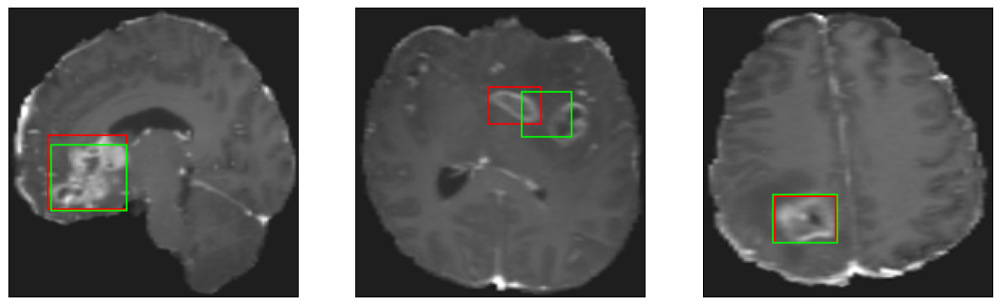

52/52 [==============================] - 7s 136ms/step - loss: 2.0300 - IoU: 0.8156 - val_loss: 4.0708 - val_IoU: 0.7192


In [ ]:
#Model Fitting
hist = model.fit(
        train_dataset,
        epochs=150,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

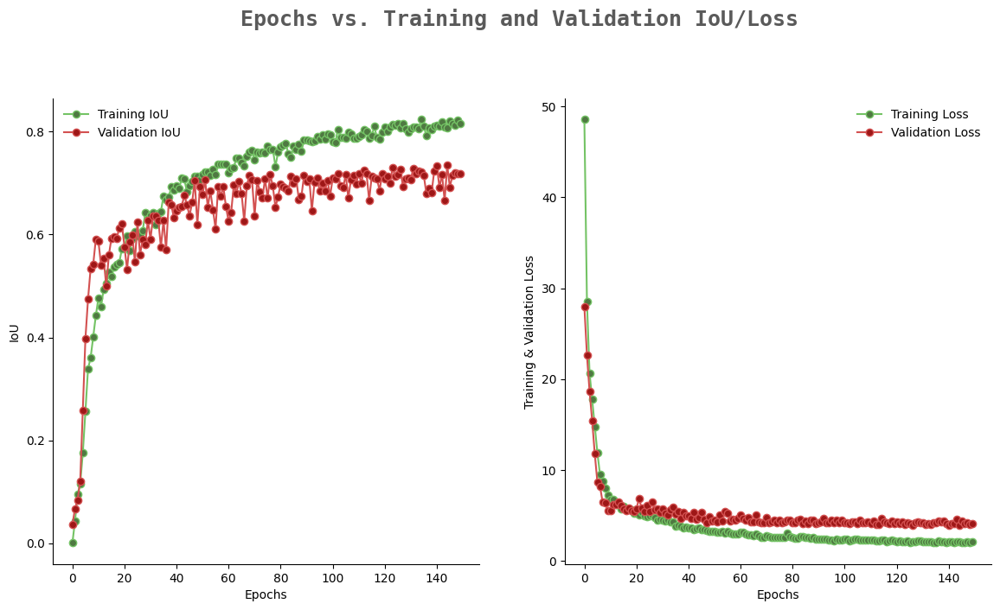

In [ ]:
#History Plot
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(150)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [ ]:
#Load the model with better results
model = tf.keras.models.load_model('./model_checkpoint_EFFNET/model_EFFNET.h5',compile = False)

In [ ]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [ ]:
#Model evaluation in Loss and IoU for the test_dataset
model.evaluate(train_dataset)

52/52 [==============================] - 2s 35ms/step - loss: 1.7250 - IoU: 0.8500


[1.725035309791565, 0.8499701023101807]

In [ ]:
#Model evaluation in Loss and IoU for the val_dataset
model.evaluate(val_dataset)

6/6 [==============================] - 0s 32ms/step - loss: 3.8899 - IoU: 0.7322


[3.8898508548736572, 0.7322280406951904]

In [ ]:
#Model evaluation in Loss and IoU for the train_dataset
model.evaluate(test_dataset)

15/15 [==============================] - 1s 39ms/step - loss: 4.5831 - IoU: 0.6917


[4.58311128616333, 0.6917082071304321]